In [1]:
%matplotlib inline
from spectral_cube import SpectralCube
from signal_id.utils import get_pixel_scales
from astropy import units as u
from astropy.io import fits
from astropy.convolution import convolve_fft
import matplotlib.pyplot as p
import seaborn as sns
sns.set_context('poster')
import numpy as np
import os

from skimage.exposure import rescale_intensity
import skimage.morphology as mo

from ms_tophat import prog_BTH

In [2]:
data_path = "/media/eric/Data_3/VLA/IC1613/"

cube = SpectralCube.read(os.path.join(data_path, "IC1613_NA_ICL001.fits"))

# Remove empty channels
cube = cube[38:65, 600:1500, 500:1600]


Testing the effects of different rescaling and structure approaches. The goal is to remove artifacts during the tophat filtering.

Focussing on channel 15 in the cube to save time.

**1) Rescaling the intensity between the max and 1 std. Cube beam tophat kernel used as base for structure element.**

In [3]:
resc_cube = np.empty_like(cube.filled_data[:]).value

noise_std = np.std(cube[0, :, :].value)
cube_max = cube.max().value
for i in range(27):
    resc_cube[i, :, :] = \
        rescale_intensity(cube[i, :, :].value,
                          in_range=(noise_std, cube_max),
                          out_range=(0, 255))

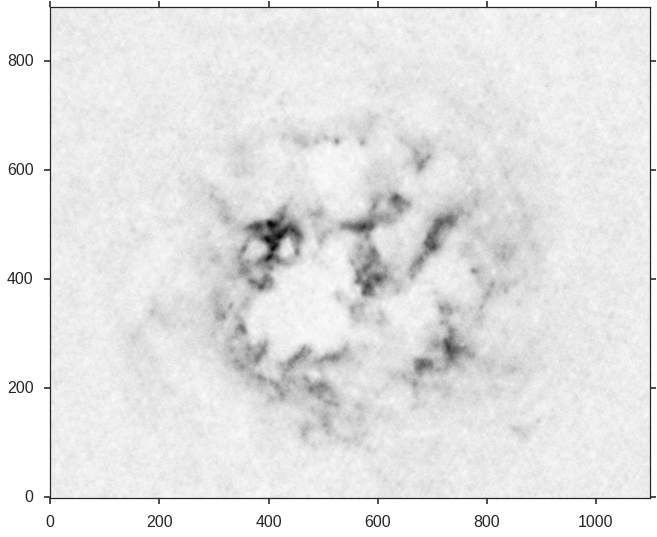

In [49]:
p.imshow(cube[15, :, :].value, origin='lower')

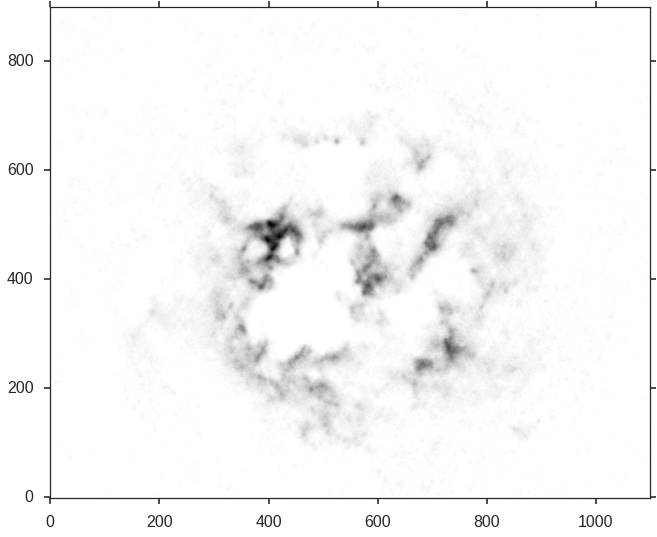

In [50]:
p.imshow(resc_cube[15, :, :], origin='lower')

In [4]:
chan_holes_1 = prog_BTH(resc_cube[15, :, :],
                      wcs=cube.wcs,
                      scales=[1, 5, 10, 20],  # N times beam width
                      beam=cube.beam)

output_1 = np.max(chan_holes_1, axis=0)



1
5
10
20


/home/eric/Dropbox/code_development/radio_astro_tools/radio_beam/radio_beam/beam.py:455: UserWarning: as_struct_element is not aware of any misaligment  between pixel and world coordinates
  warnings.warn("as_struct_element is not aware of any misaligment "


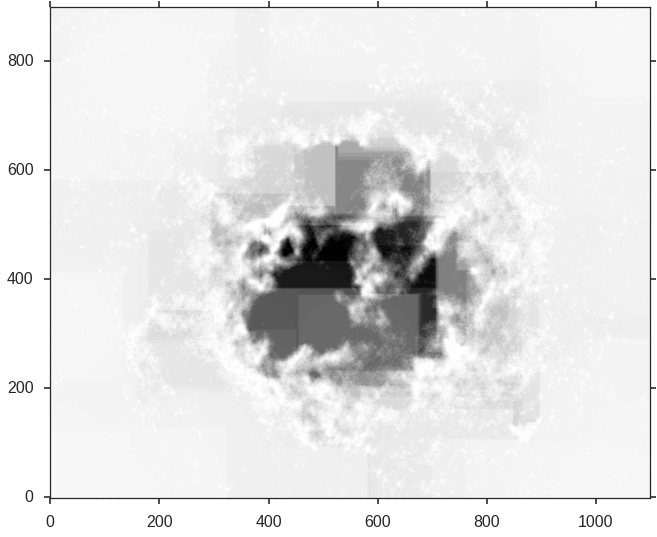

In [5]:
p.imshow(output_1, origin='lower')

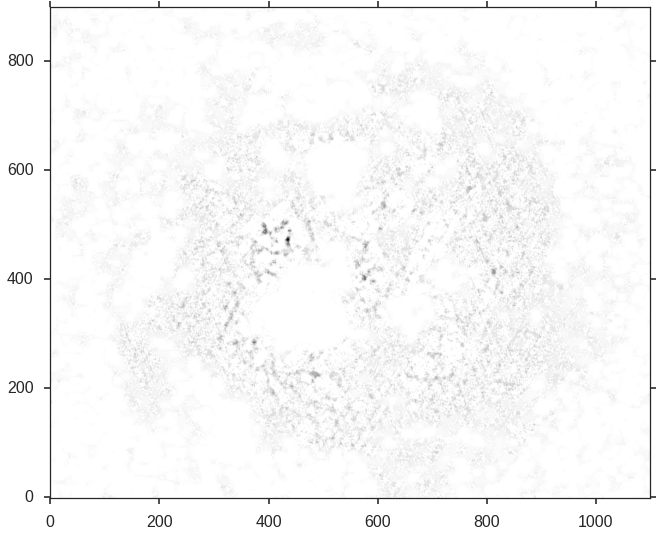

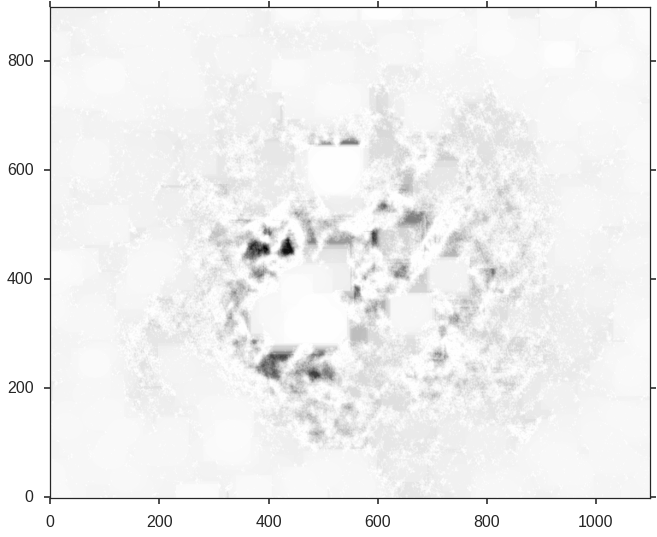

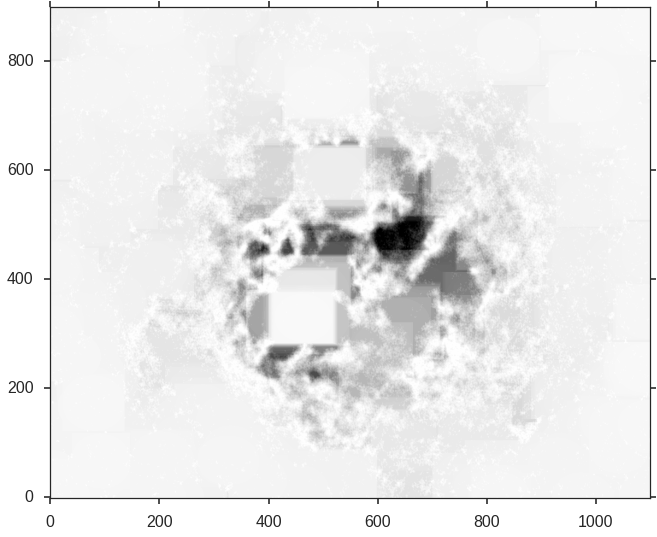

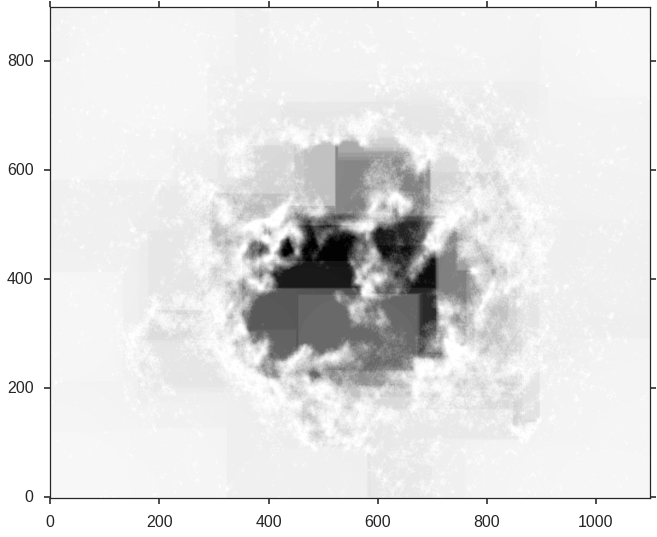

In [6]:
for i in range(4):
    p.imshow(chan_holes_1[i, :, :], origin='lower')
    p.show()

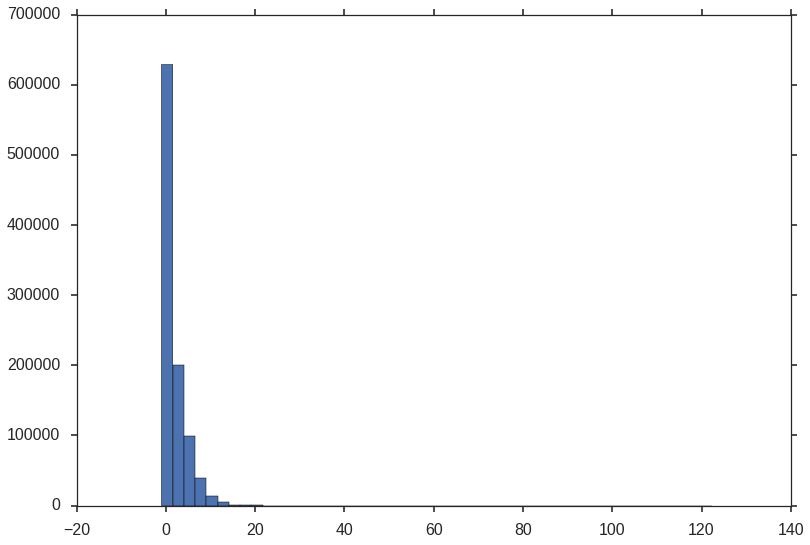

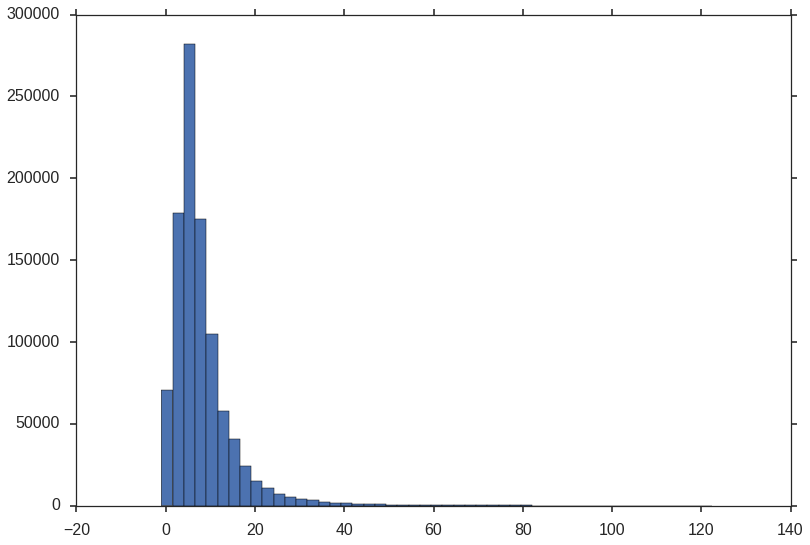

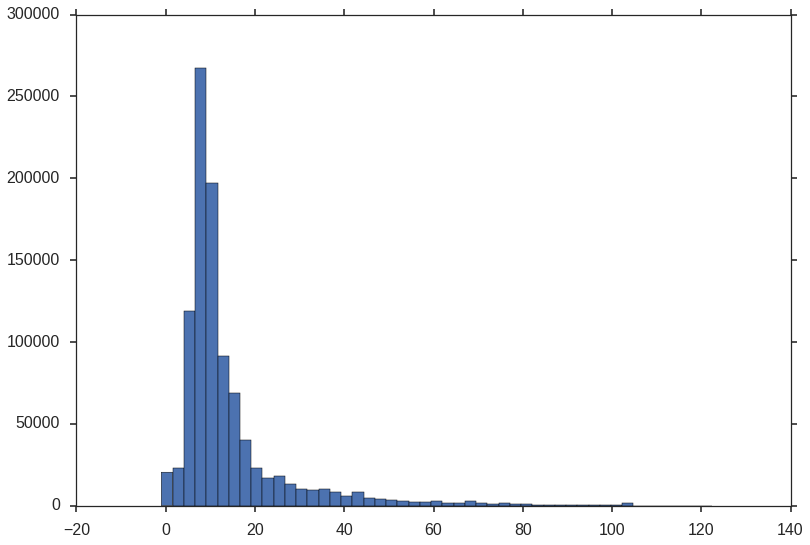

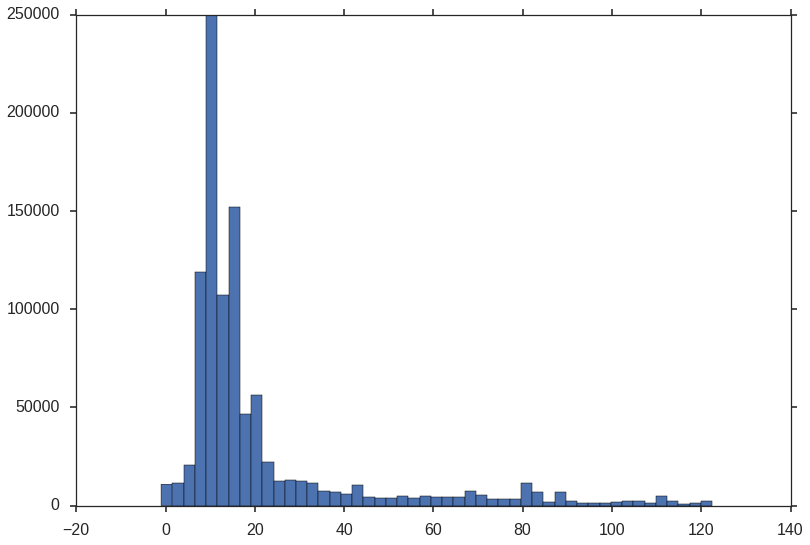

In [7]:
for i in range(4):
    p.hist(chan_holes_1[i, :, :].ravel(), bins=np.linspace(chan_holes_1.min(), chan_holes_1.max(), 50))
    p.show()

Noticable artifacts. Seems like the edges of the structure element are somehow included??

**2) No rescaling, beam scales for structures**

In [8]:
chan_holes_2 = prog_BTH(cube[15, :, :].value,
                      wcs=cube.wcs,
                      scales=[1, 5, 10, 20],  # N times beam width
                      beam=cube.beam)

output_2 = np.max(chan_holes_2, axis=0)

1
5
10
20


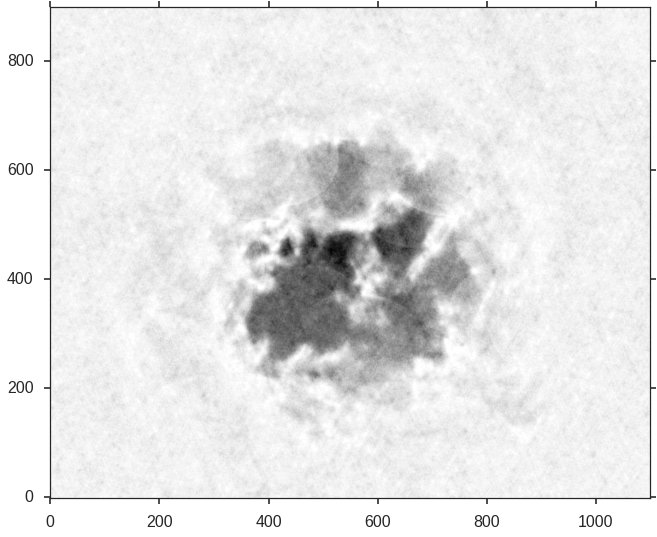

In [9]:
p.imshow(output_2, origin='lower')

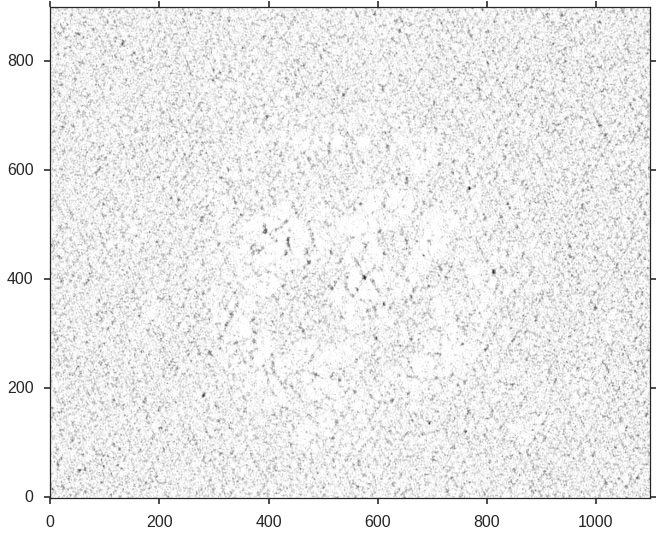

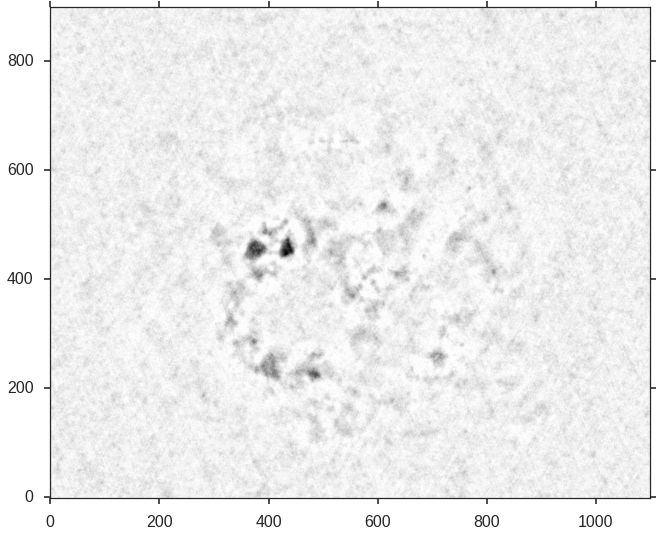

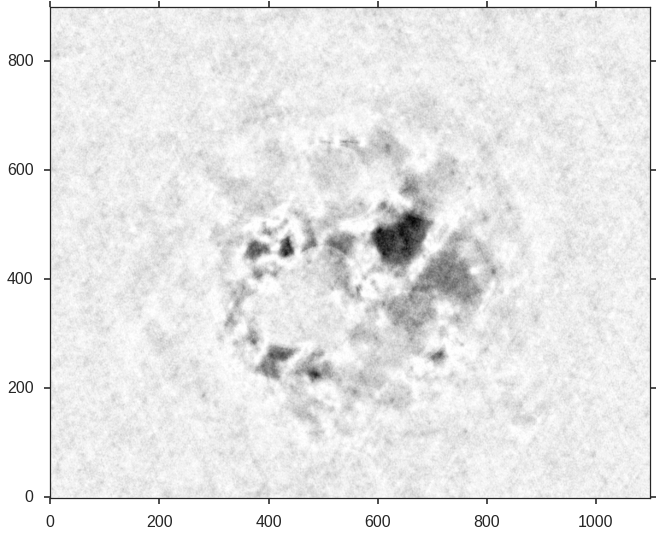

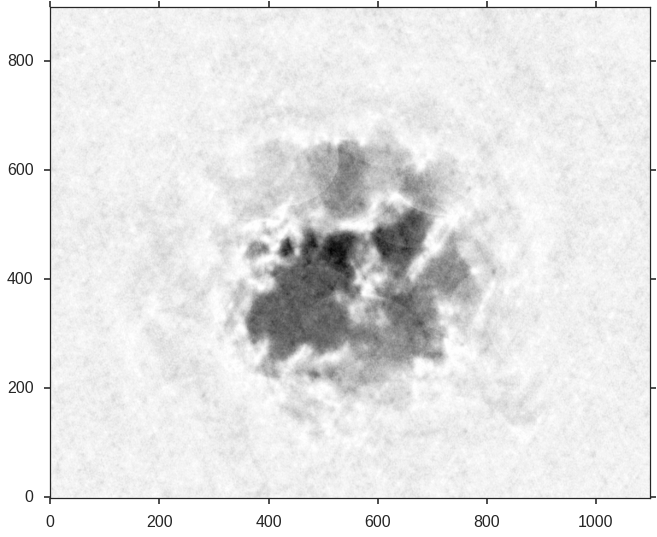

In [10]:
for i in range(4):
    p.imshow(chan_holes_2[i, :, :], origin='lower')
    p.show()

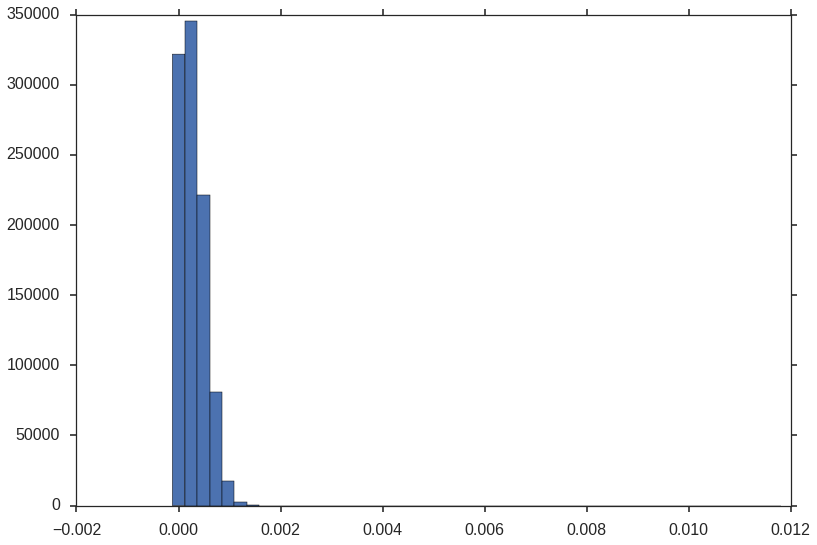

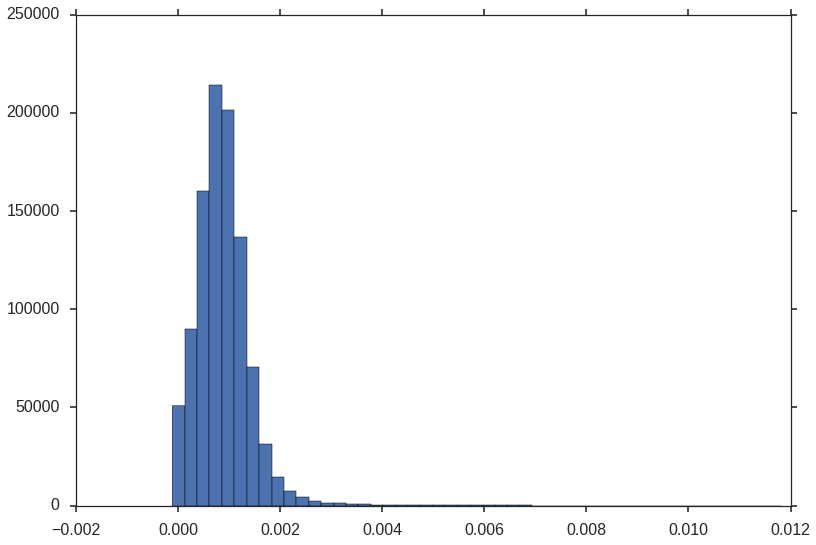

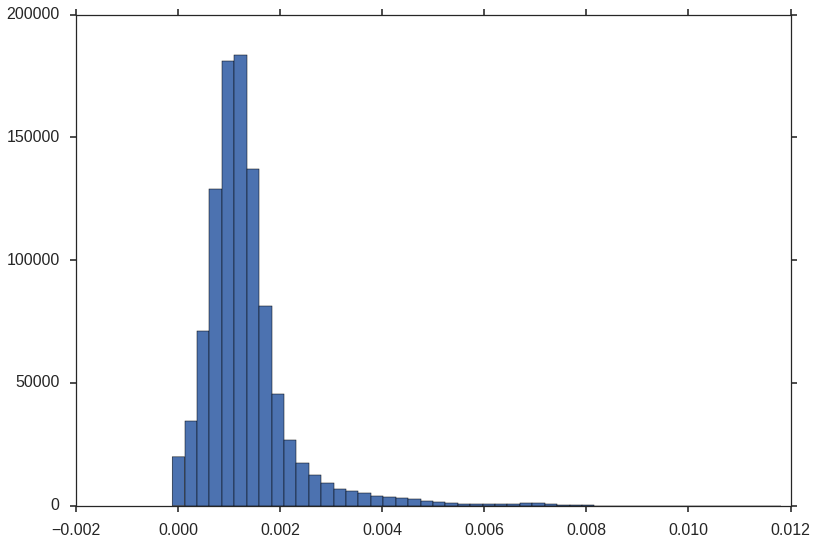

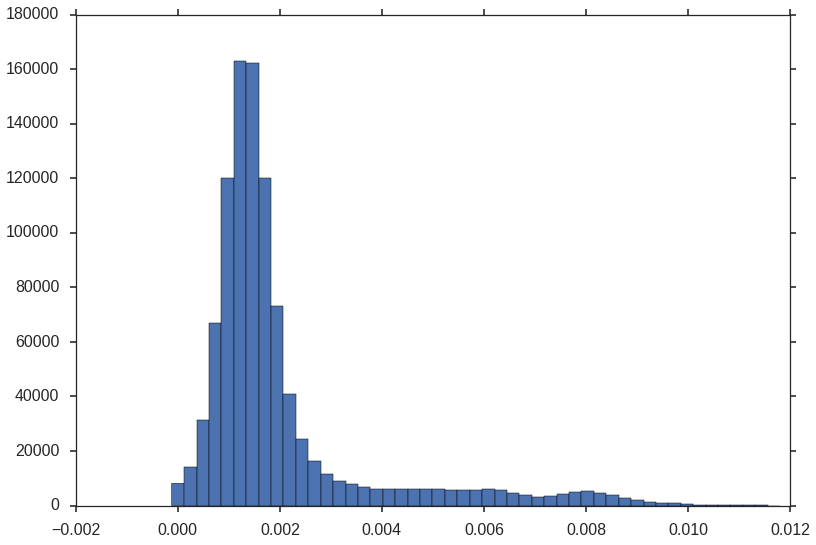

In [11]:
for i in range(4):
    p.hist(chan_holes_2[i, :, :].ravel(), bins=np.linspace(chan_holes_2.min(), chan_holes_2.max(), 50))
    p.show()

Much more minimal artifacts. They actually look like the element now! Not sure why the rescaled data has such an adverse affect to the square shape of the overall structure array...

Double check what the beam structures are looking like:

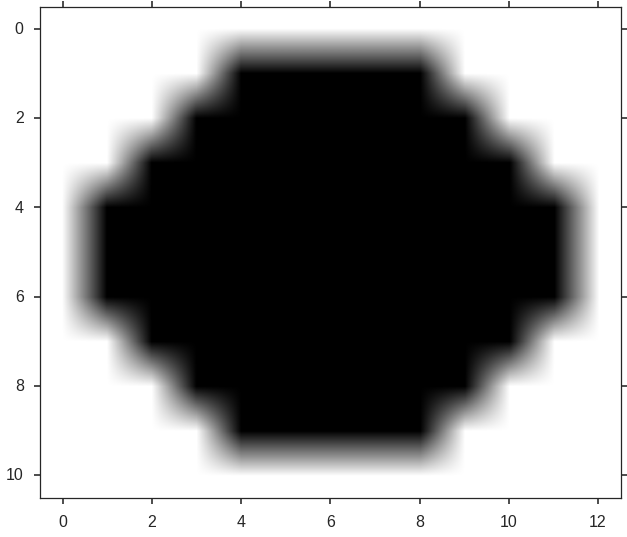

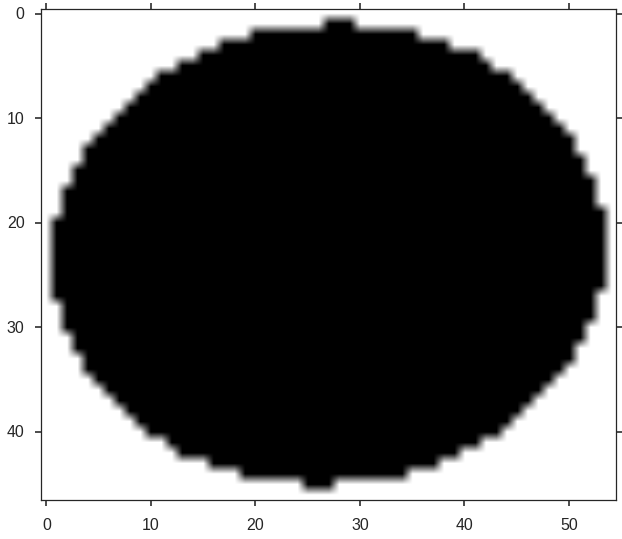

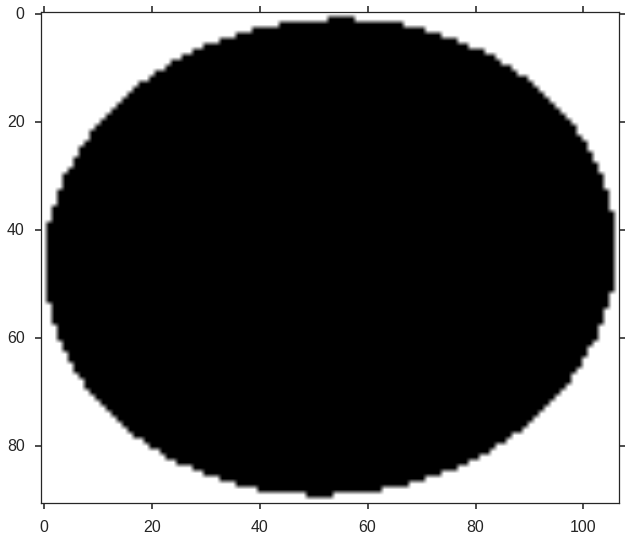

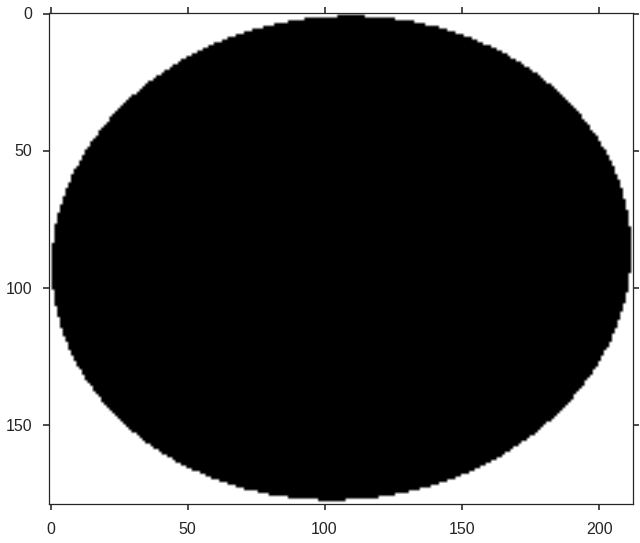

In [12]:
scales = [1, 5, 10, 20]

for i, scale in enumerate(scales):
    if scale == 1:
        scale_beam = cube.beam
    else:
        scale_beam = Beam(major=scale*cube.beam.major, minor=scale*cube.beam.minor, pa=cube.beam.pa)
        
    struct = scale_beam.as_tophat_kernel(get_pixel_scales(cube.wcs)).array > 0.0
    struct = struct.astype(int)
    yposn, xposn = np.where(struct > 0)
    struct = \
                struct[np.min(yposn)-1:np.max(yposn)+2, np.min(xposn)-1:np.max(xposn)+2]
    p.imshow(struct)
    p.show()

Looks fine!

**3) No rescaling, disk structures**

In [53]:
chan_holes_3 = prog_BTH(cube[15, :, :].value,
                        structures=[mo.disk(5*i) for i in [1, 5, 10, 20]])

output_3 = np.max(chan_holes_3, axis=0)

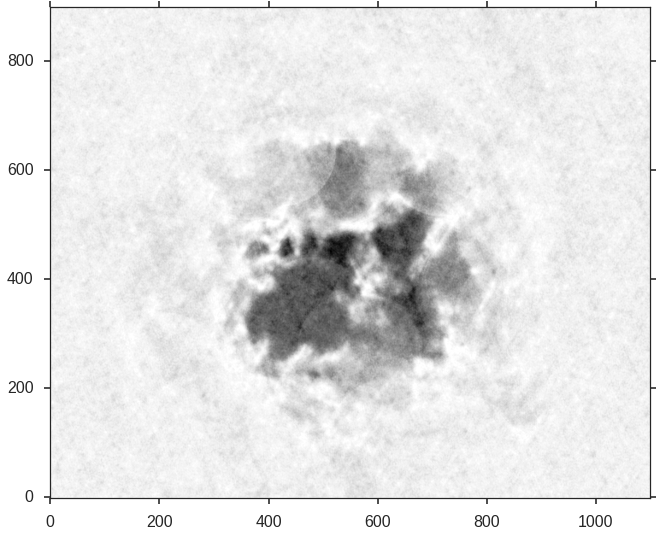

In [54]:
p.imshow(output_3, origin='lower')

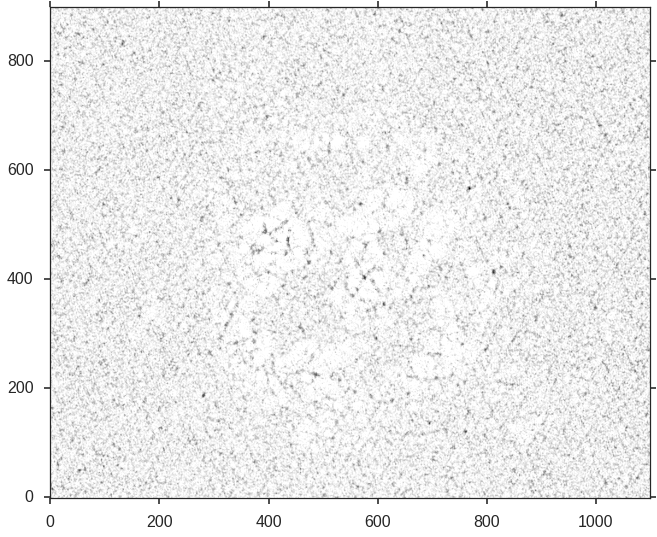

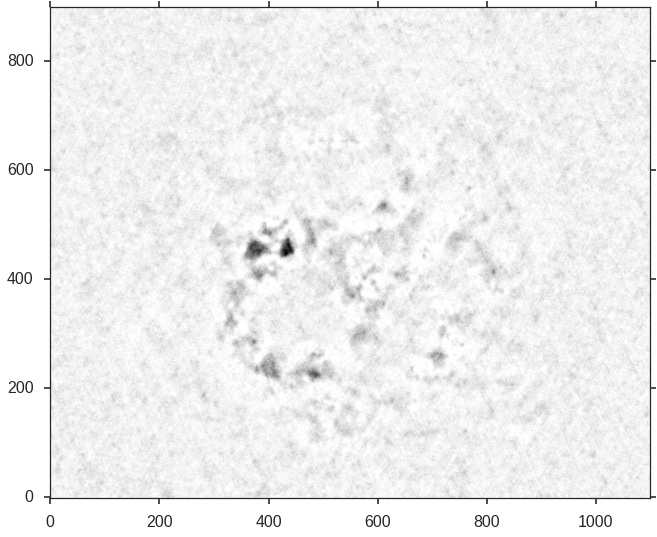

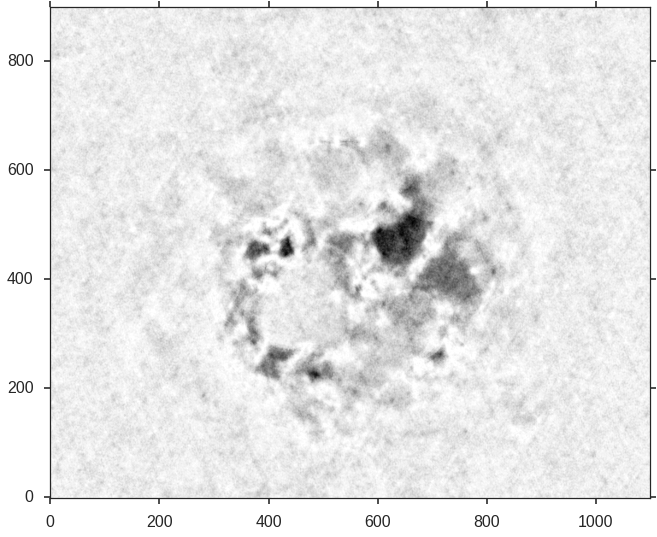

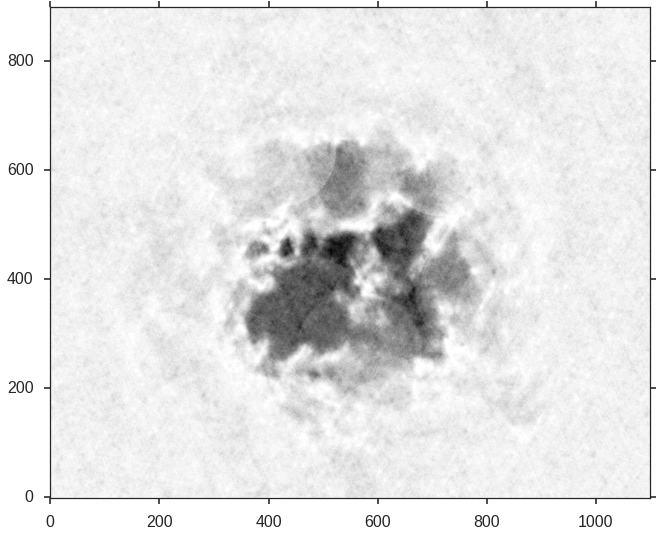

In [55]:
for i in range(4):
    p.imshow(chan_holes_3[i, :, :], origin='lower')
    p.show()

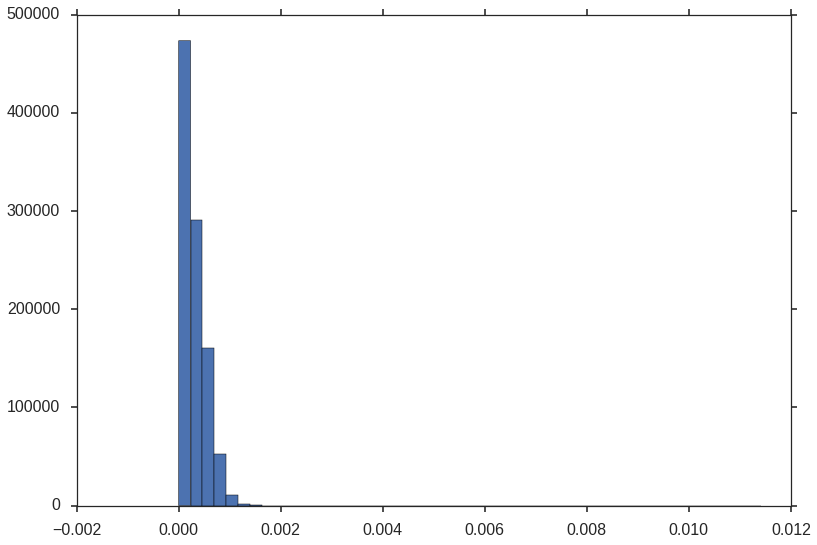

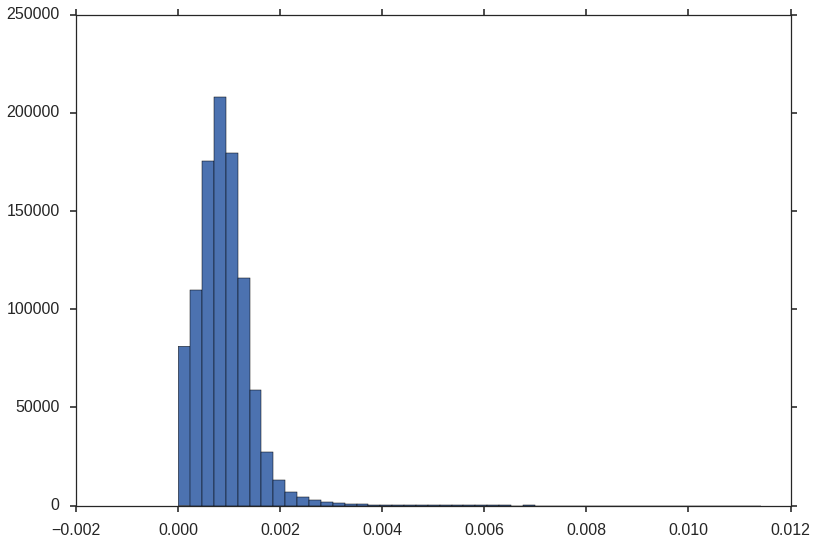

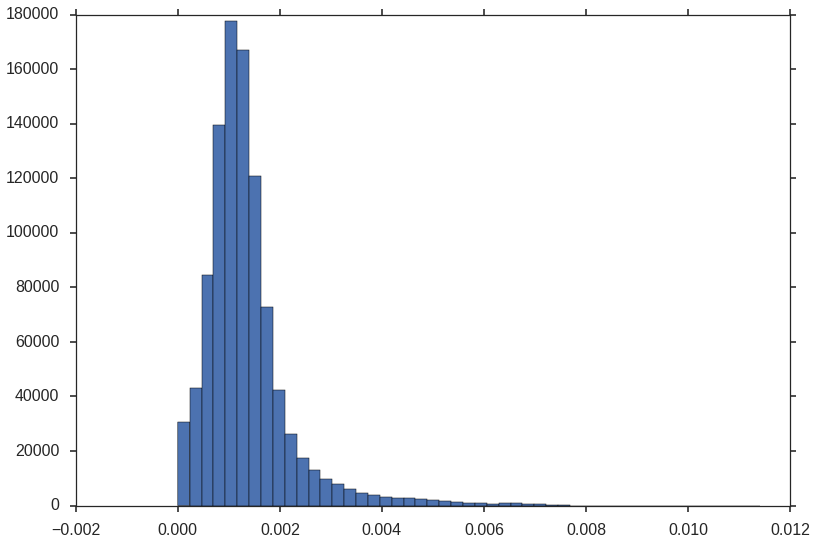

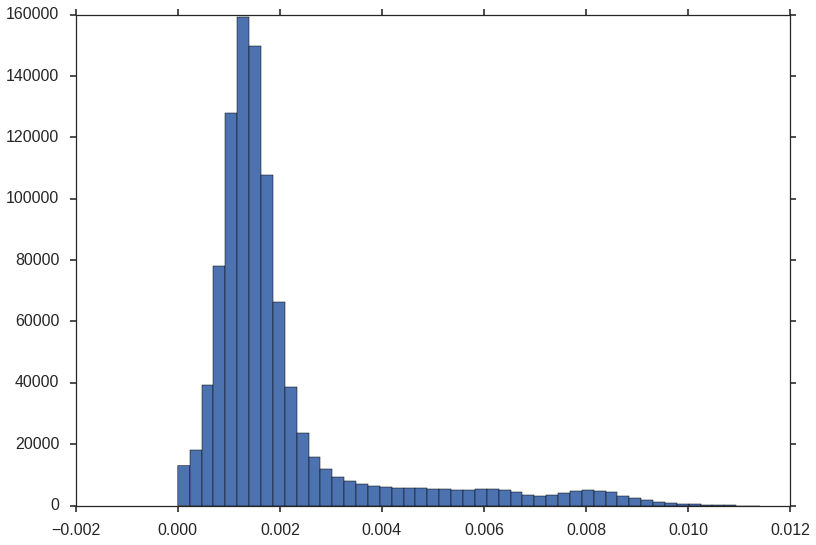

In [56]:
for i in range(4):
    p.hist(chan_holes_3[i, :, :].ravel(), bins=np.linspace(chan_holes_3.min(), chan_holes_3.max(), 50))
    p.show()

Basically identical, as was kind of expected.

**4) No rescale, square elements**

In [17]:
chan_holes_4 = prog_BTH(cube[15, :, :].value,
                        structures=[mo.square(10*i) for i in [1, 5, 10, 20]])

output_4 = np.max(chan_holes_4, axis=0)

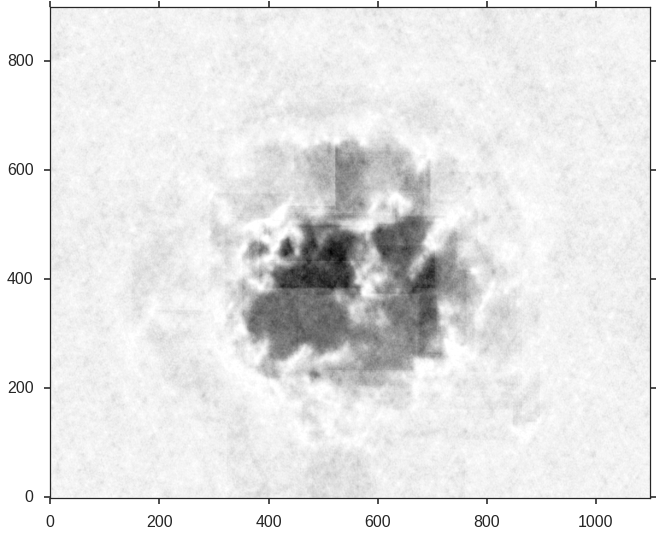

In [21]:
output_4 = np.max(chan_holes_4, axis=0)
p.imshow(output_4, origin='lower')

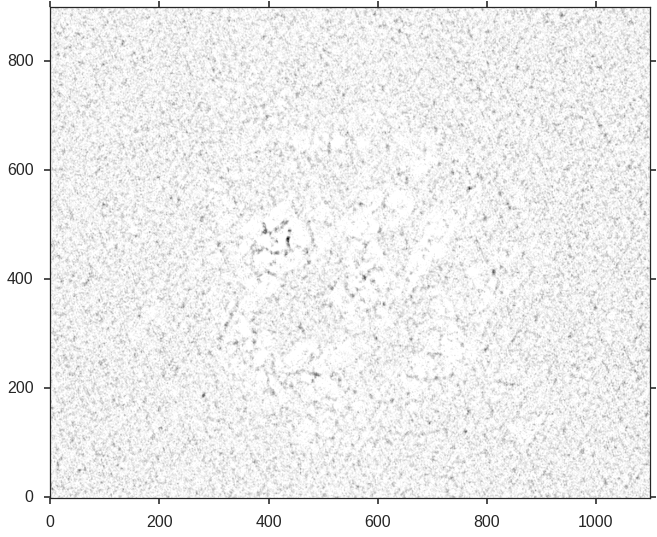

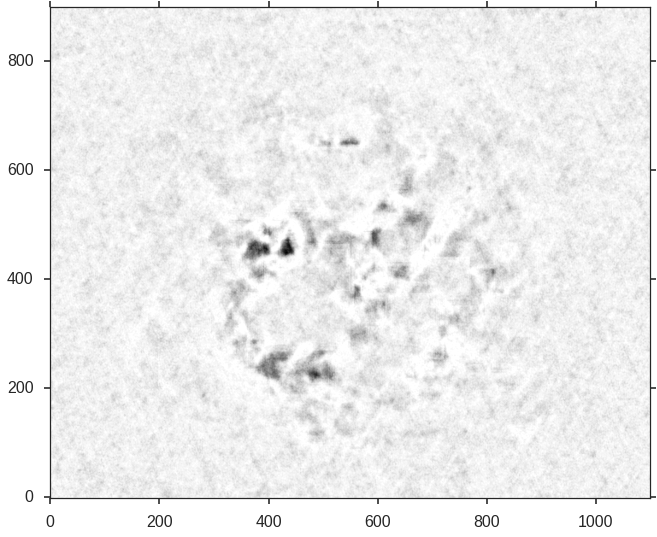

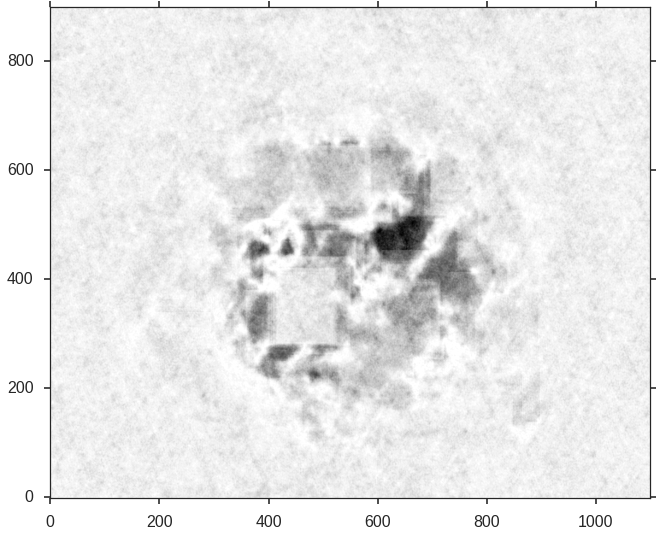

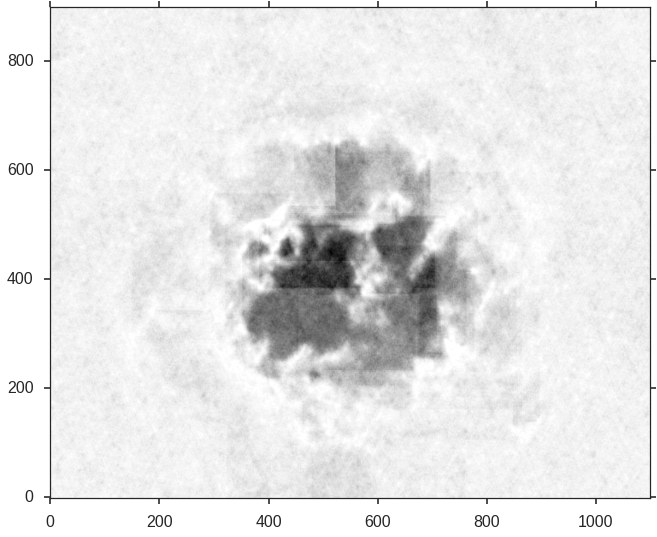

In [19]:
for i in range(4):
    p.imshow(chan_holes_4[i, :, :], origin='lower')
    p.show()

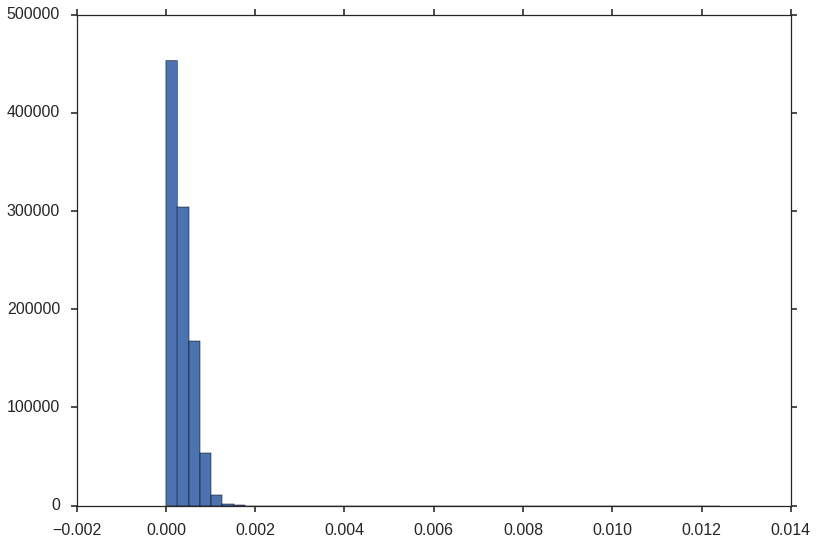

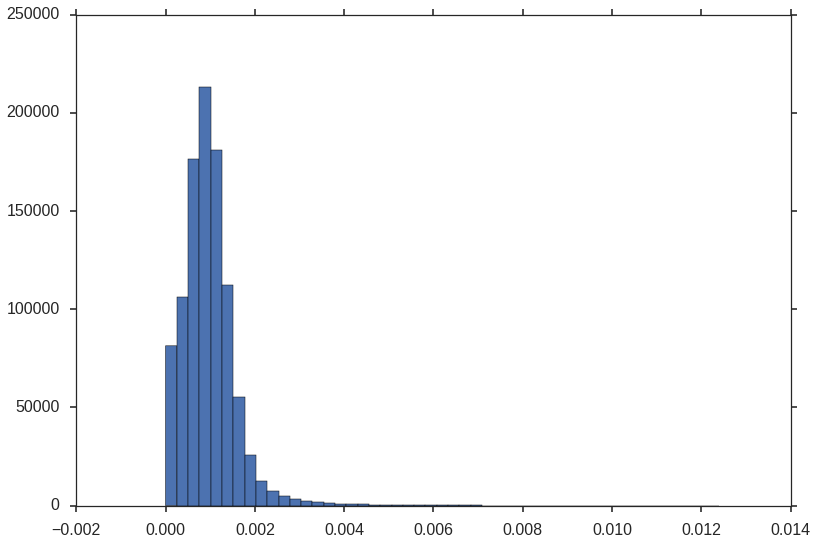

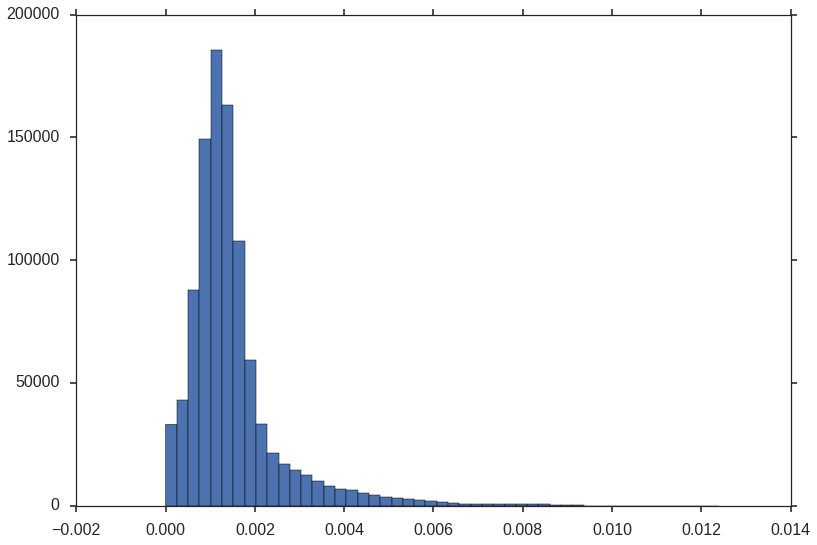

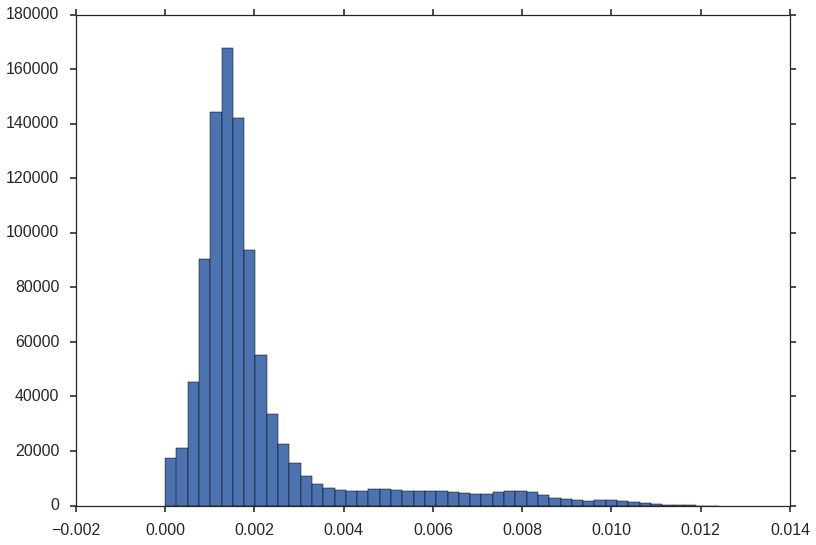

In [20]:
for i in range(4):
    p.hist(chan_holes_4[i, :, :].ravel(), bins=np.linspace(chan_holes_4.min(), chan_holes_4.max(), 50))
    p.show()

Square artifacts, not as extreme as in case 1.

**5) Rescaled with disk structures **

In [22]:
chan_holes_5 = prog_BTH(resc_cube[15, :, :],
                        structures=[mo.disk(5*i) for i in [1, 5, 10, 20]])

output_5 = np.max(chan_holes_5, axis=0)

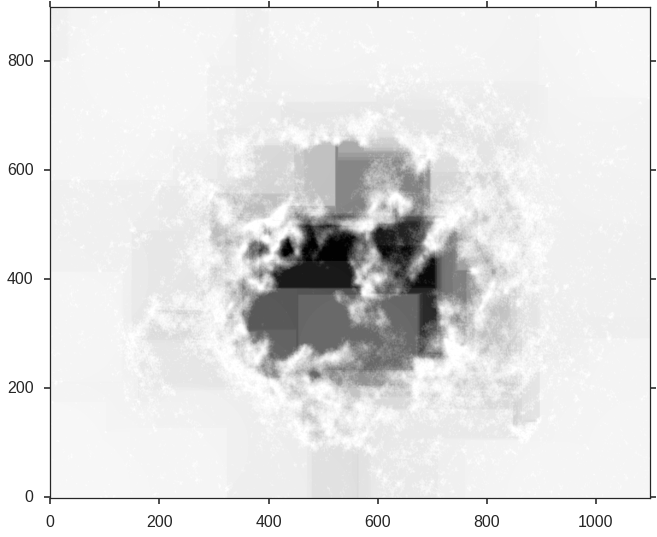

In [23]:
p.imshow(output_5, origin='lower')

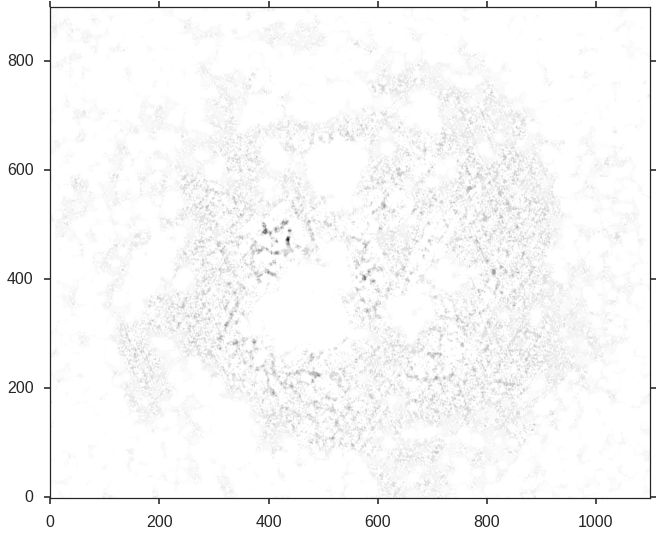

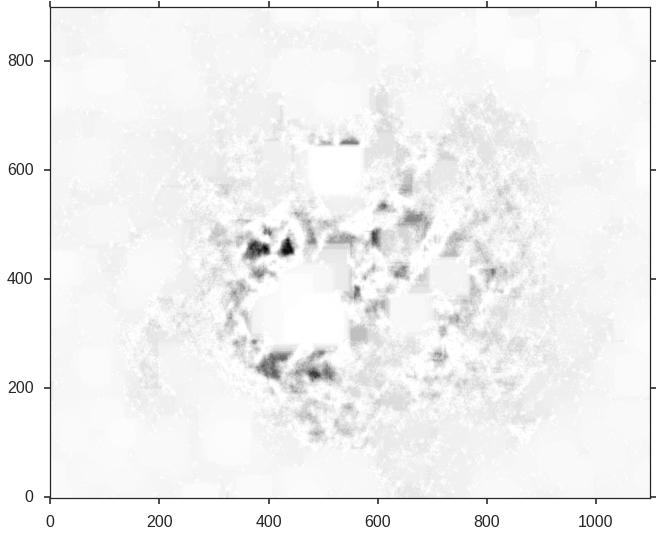

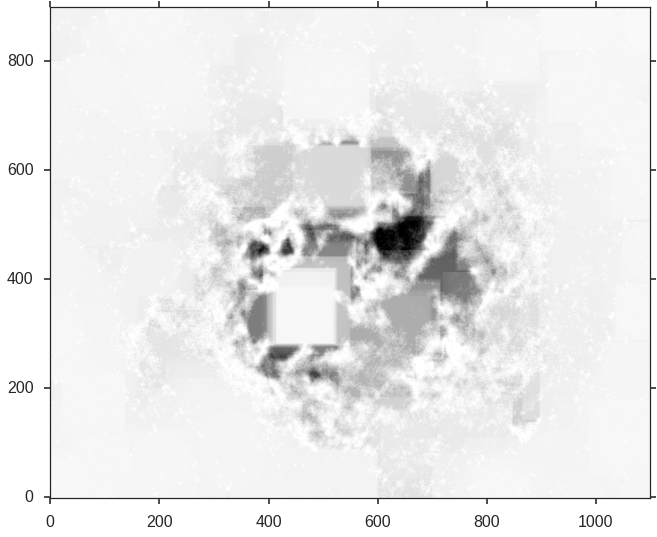

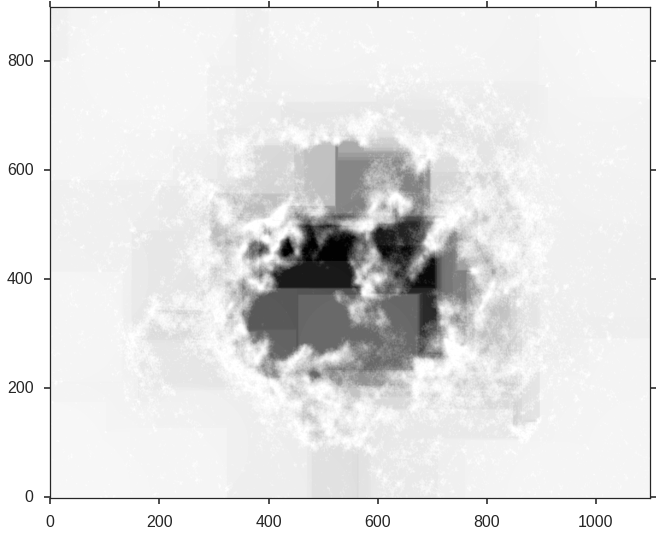

In [24]:
for i in range(4):
    p.imshow(chan_holes_5[i, :, :], origin='lower')
    p.show()

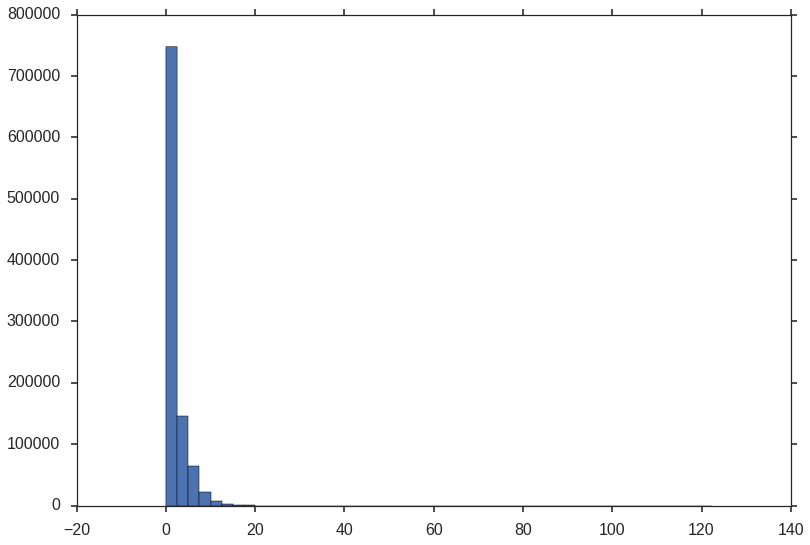

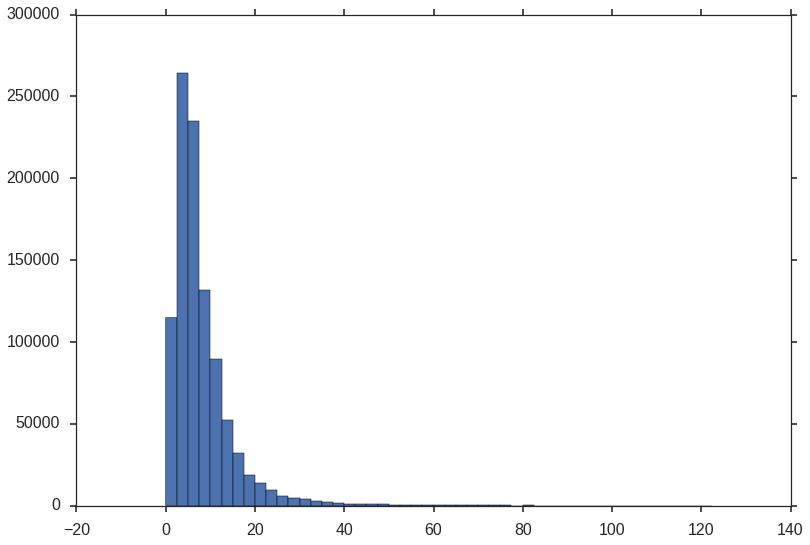

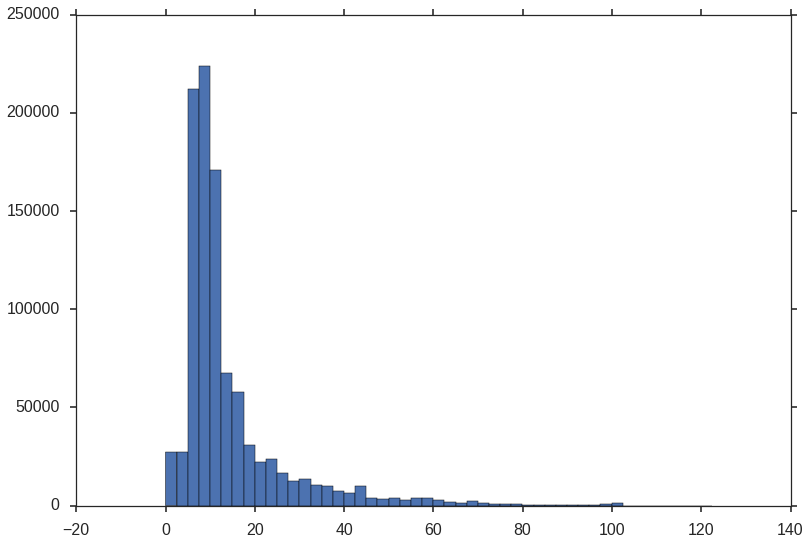

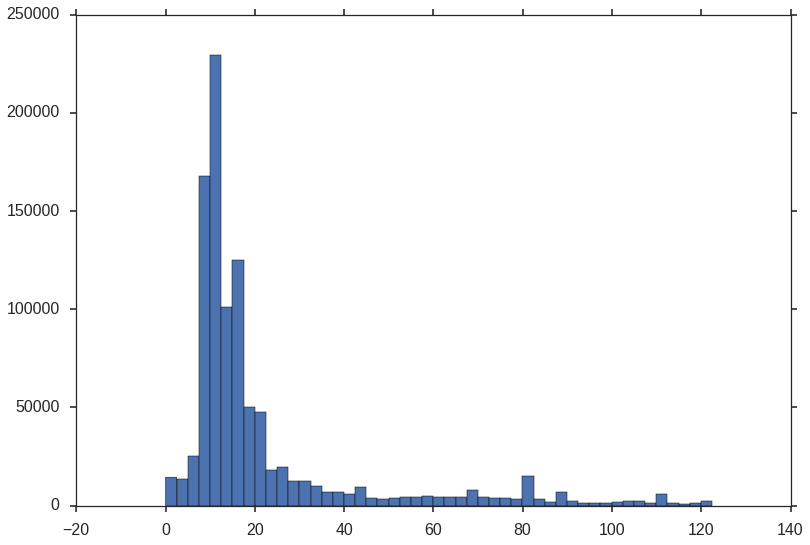

In [25]:
for i in range(4):
    p.hist(chan_holes_5[i, :, :].ravel(), bins=np.linspace(chan_holes_5.min(), chan_holes_5.max(), 50))
    p.show()

Hmm, square artifacts again?

**6) No rescaling with gaussian beam**

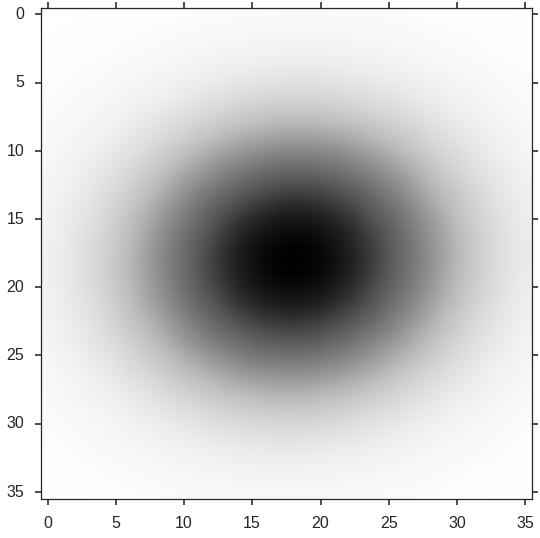

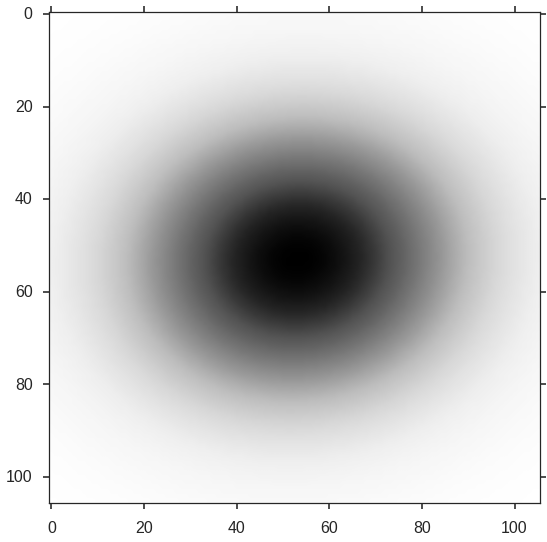

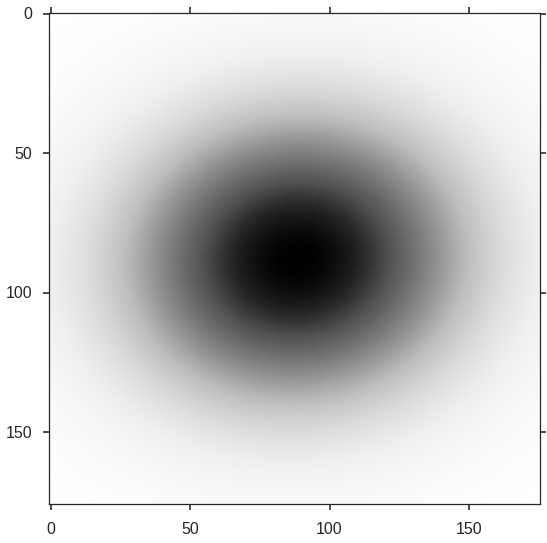

In [42]:
scales = [1, 3, 5]
structures = []

for i, scale in enumerate(scales):
    if scale == 1:
        scale_beam = cube.beam
    else:
        scale_beam = Beam(major=scale*cube.beam.major, minor=scale*cube.beam.minor, pa=cube.beam.pa)
        
    struct = scale_beam.as_kernel(get_pixel_scales(cube.wcs)).array
    
    shape = struct.shape
    structures.append(struct[int(shape[0]*0.25):int(shape[0]*0.75), int(shape[1]*0.3):int(shape[1]*0.7)])
    
    p.imshow(struct[int(shape[0]*0.25):int(shape[0]*0.75), int(shape[1]*0.25):int(shape[1]*0.75)])
    p.show()

In [43]:
chan_holes_6 = prog_BTH(cube[15, :, :].value,
                        structures=structures)

output_6 = np.max(chan_holes_6, axis=0)

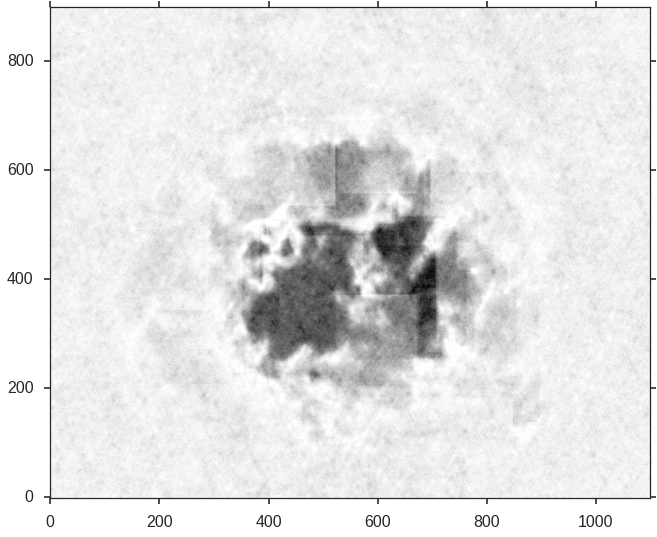

In [44]:
p.imshow(output_6, origin='lower')

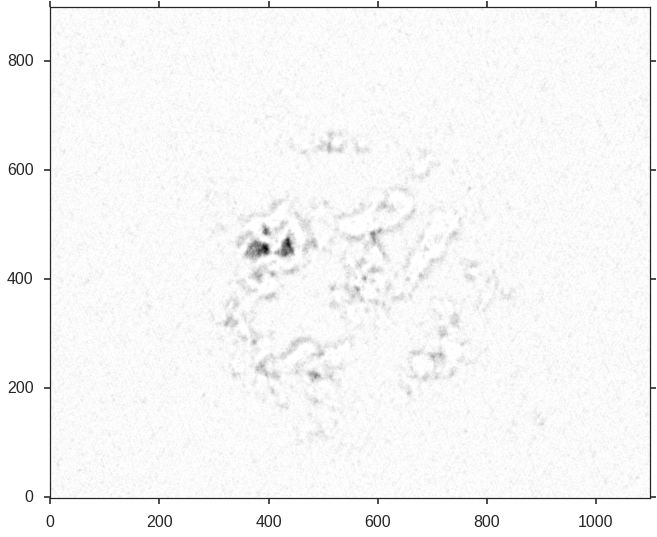

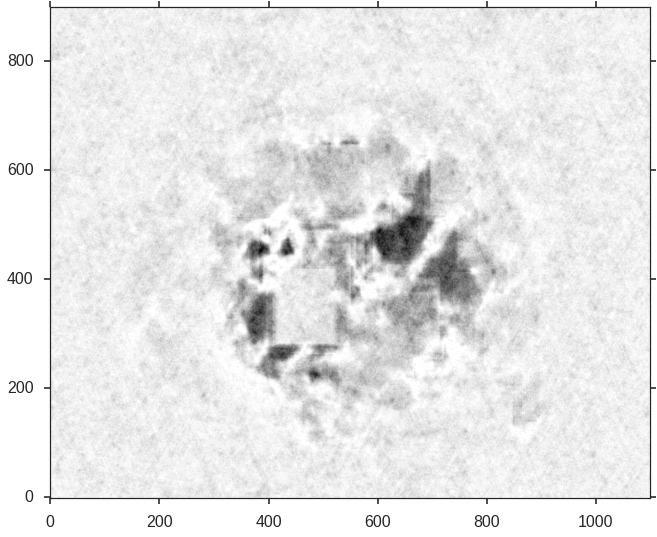

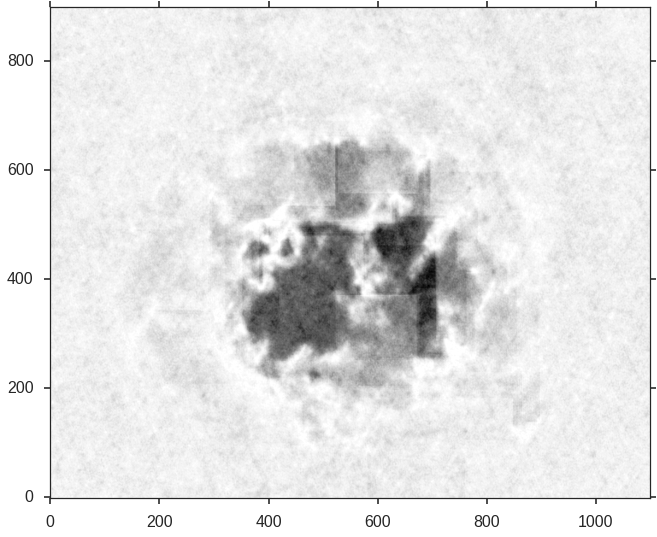

In [47]:
for i in range(3):
    p.imshow(chan_holes_6[i, :, :], origin='lower')
    p.show()

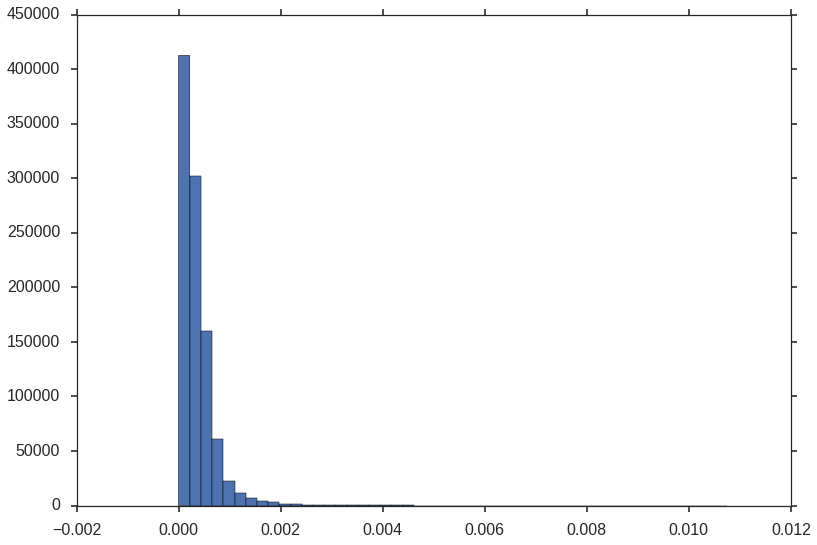

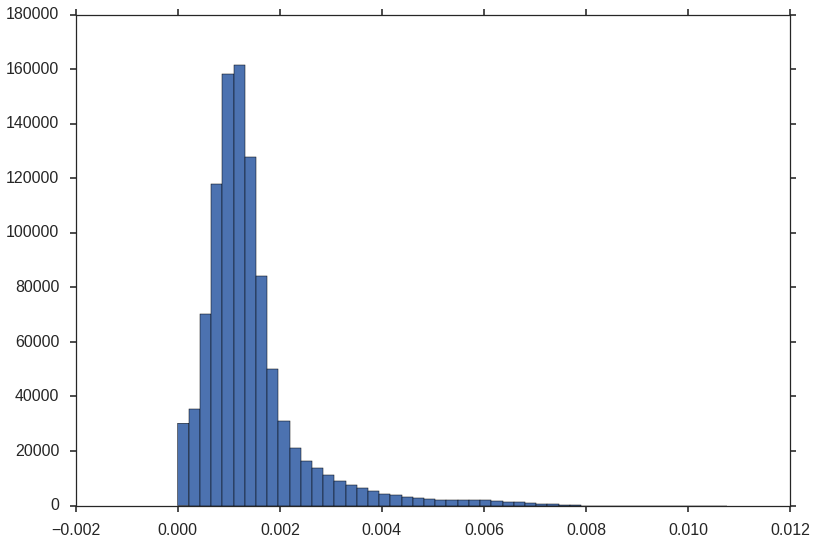

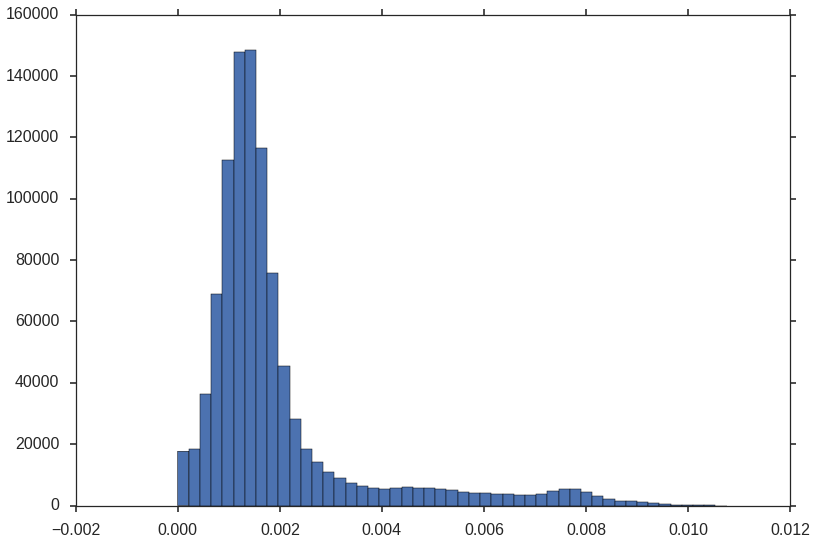

In [48]:
for i in range(3):
    p.hist(chan_holes_6[i, :, :].ravel(), bins=np.linspace(chan_holes_6.min(), chan_holes_6.max(), 50))
    p.show()

**7) arcsinh data tranform, beam scale structures**

Since I don't care about the emission more than *is any there*, severely flattening the image should help with the artifacts.

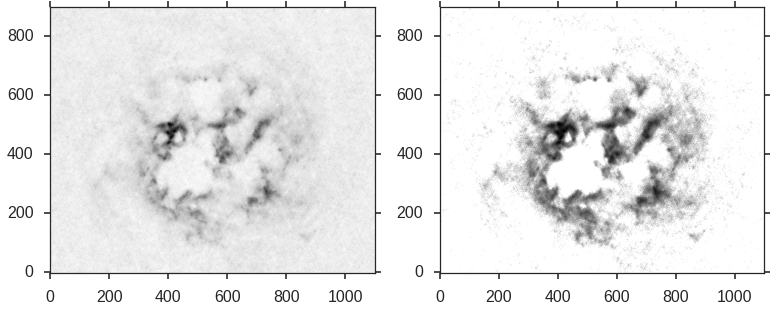

In [72]:
from astropy.visualization import scale_image

cube_15_arcsinh = scale_image(cube[15, :, :].value, min_cut=noise_std, scale='asinh', asinh_a=0.1, clip=True)

p.subplot(121)
p.imshow(cube[15, :, :].value, origin='lower')
p.subplot(122)
p.imshow(cube_15_arcsinh, origin='lower')

Looks better than the initial rescaling. The `clip` behaviour is a little interesting. I'm not sure if the hard edge to zeroed regions will cause more artifacts.

In [74]:
chan_holes_7 = prog_BTH(cube_15_arcsinh,
                      wcs=cube.wcs,
                      scales=[1, 5, 10, 20],  # N times beam width
                      beam=cube.beam)

output_7 = np.max(chan_holes_7, axis=0)

1
5
10
20


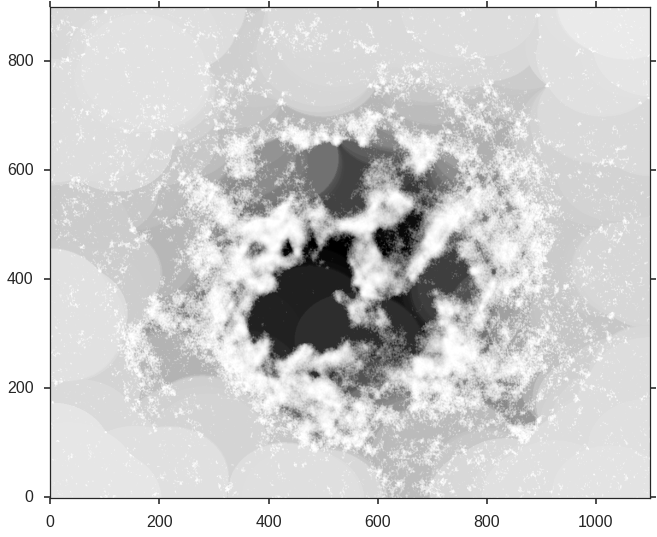

In [75]:
p.imshow(output_7, origin='lower')

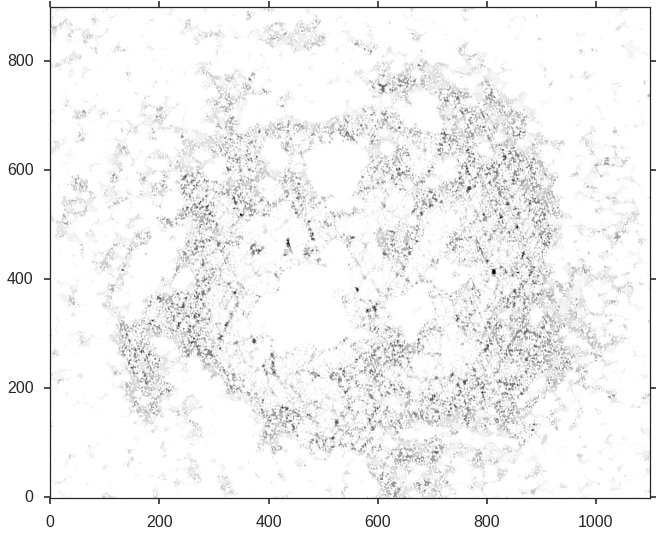

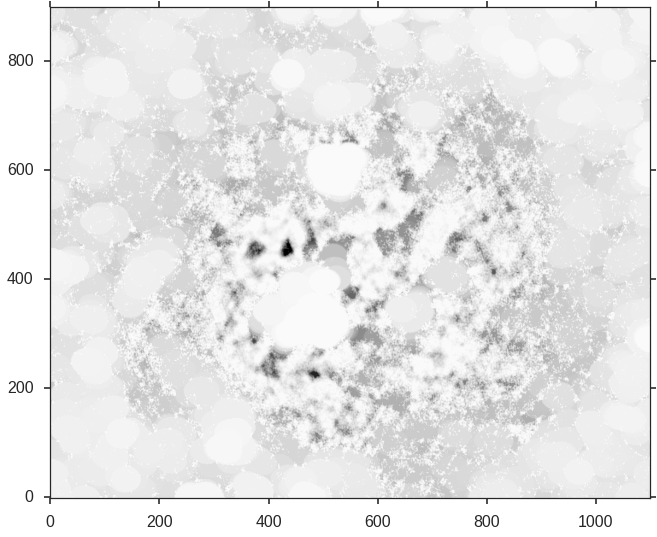

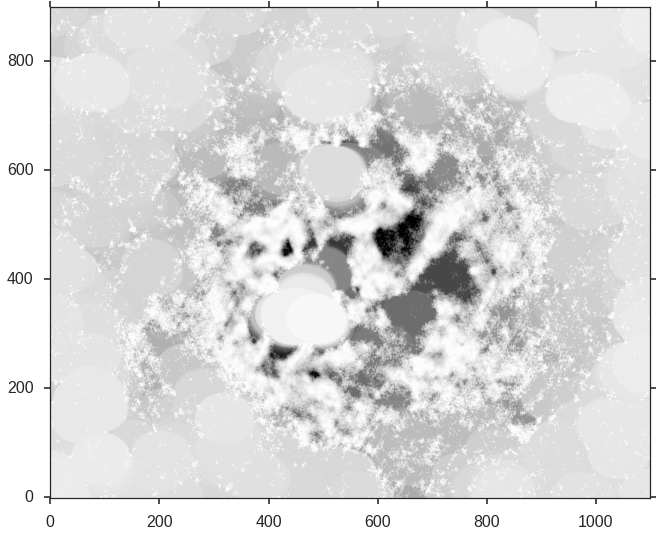

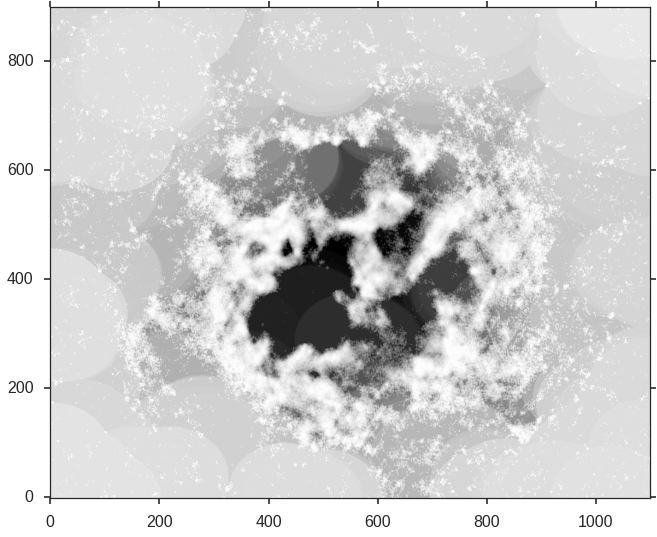

In [76]:
for i in range(4):
    p.imshow(chan_holes_7[i, :, :], origin='lower')
    p.show()

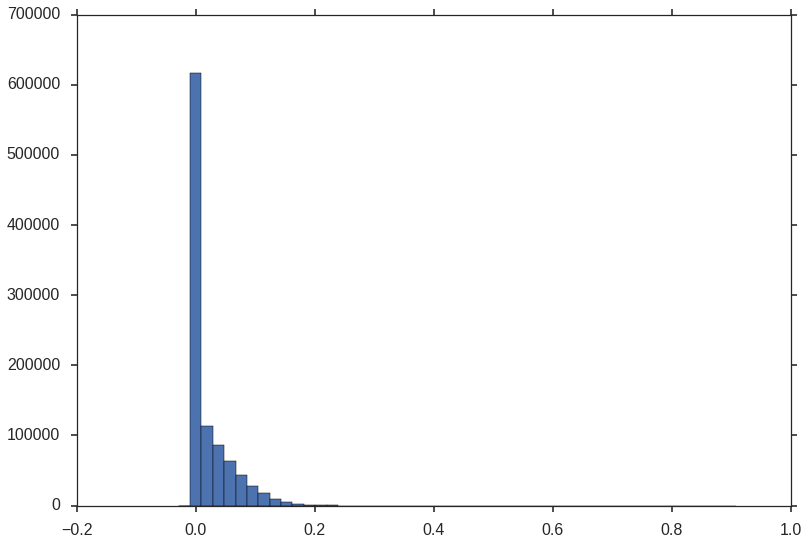

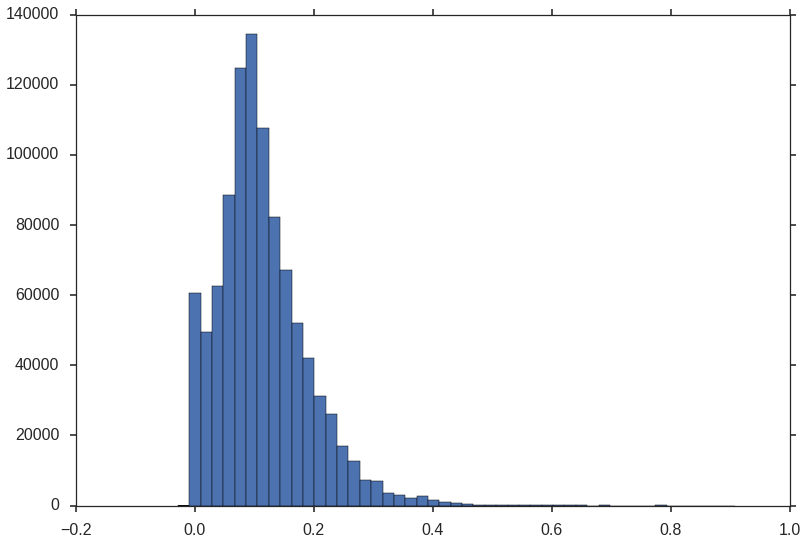

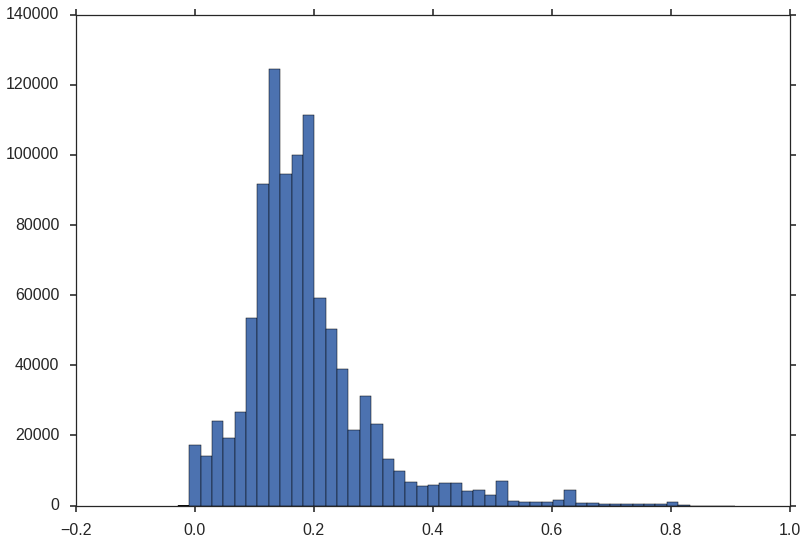

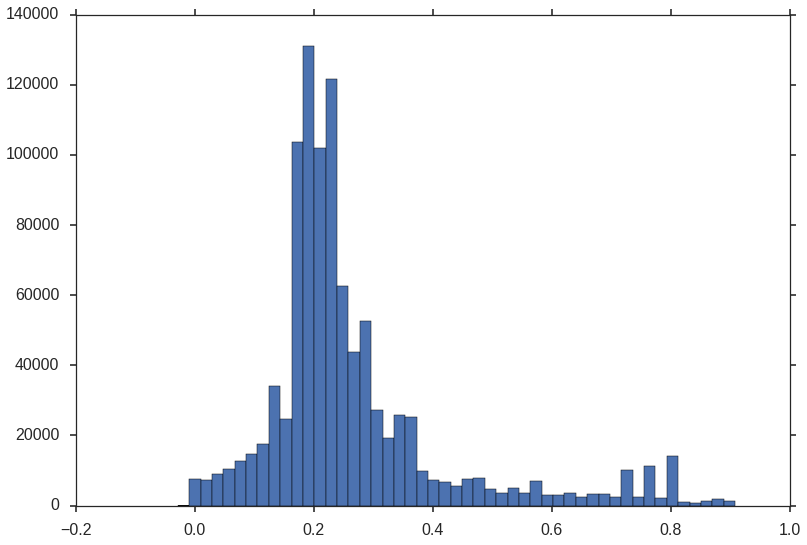

In [77]:
for i in range(4):
    p.hist(chan_holes_7[i, :, :].ravel(), bins=np.linspace(chan_holes_7.min(), chan_holes_7.max(), 50))
    p.show()

Artifacts likely from the cutoff created using `clip`. Try without it.


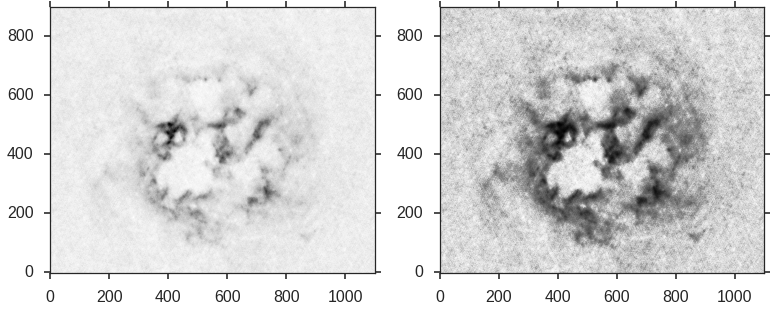

In [87]:
cube_15_arcsinh_noclip = scale_image(cube[15, :, :].value, min_cut=noise_std, scale='asinh', asinh_a=0.1, clip=False)

p.subplot(121)
p.imshow(cube[15, :, :].value, origin='lower')
p.subplot(122)
p.imshow(cube_15_arcsinh_noclip, origin='lower')

In [80]:
chan_holes_7_nc = prog_BTH(cube_15_arcsinh_noclip,
                      wcs=cube.wcs,
                      scales=[1, 5, 10, 20],  # N times beam width
                      beam=cube.beam)

output_7_nc = np.max(chan_holes_7_nc, axis=0)

1
5
10
20


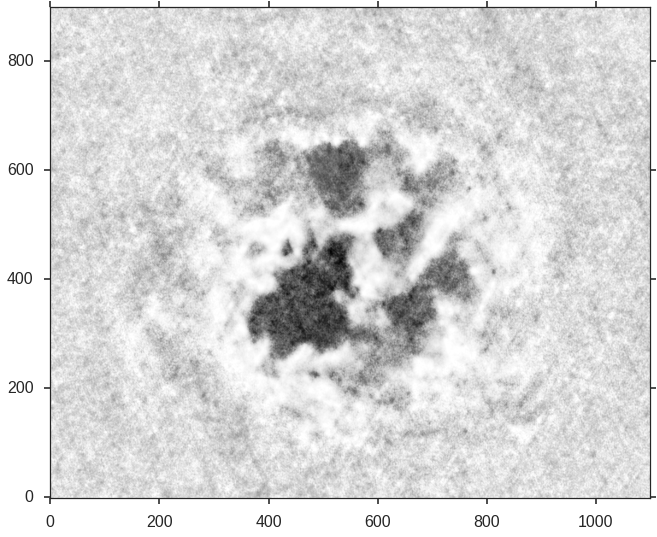

In [81]:
p.imshow(output_7_nc, origin='lower')

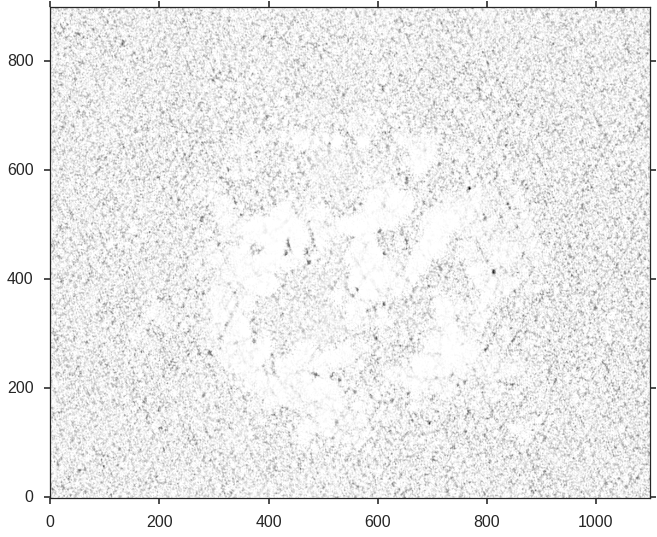

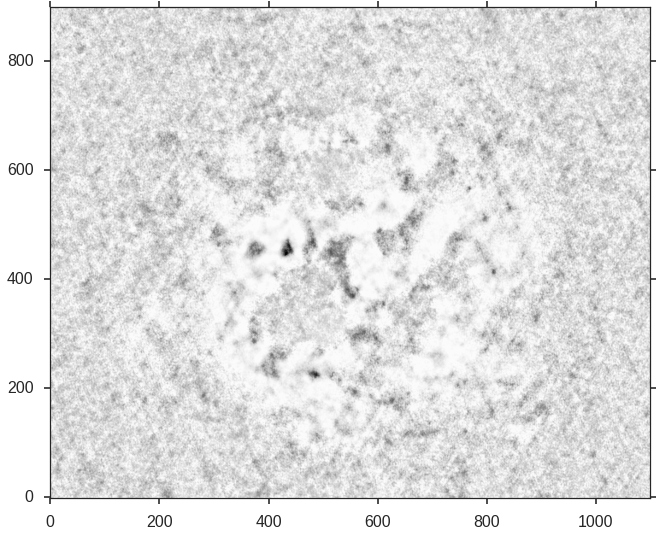

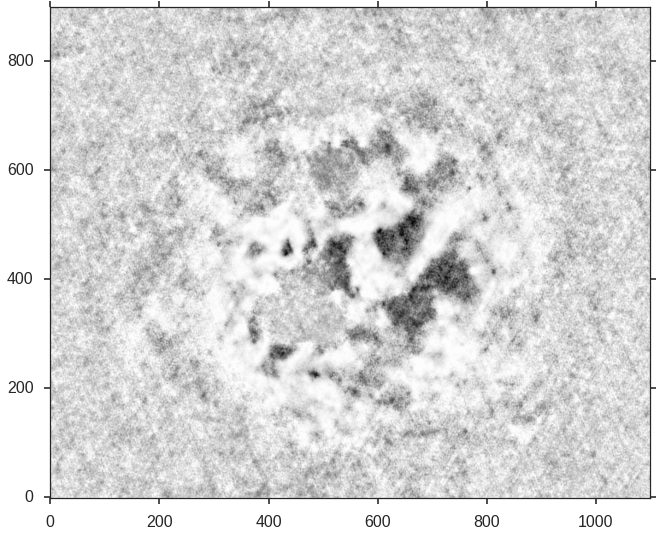

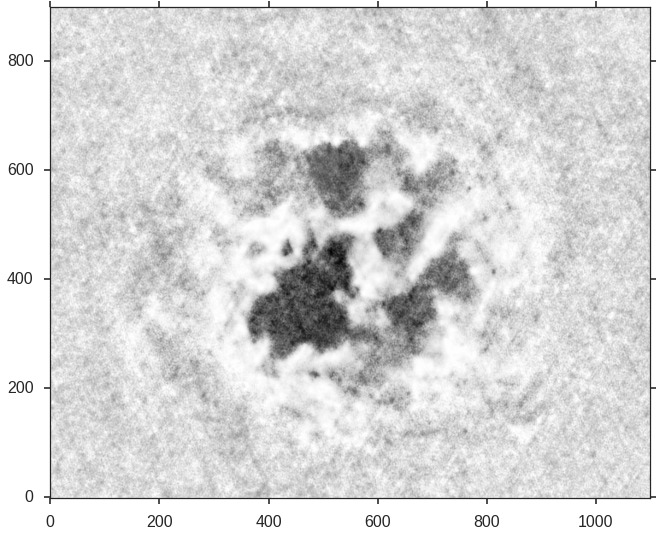

In [82]:
for i in range(4):
    p.imshow(chan_holes_7_nc[i, :, :], origin='lower')
    p.show()

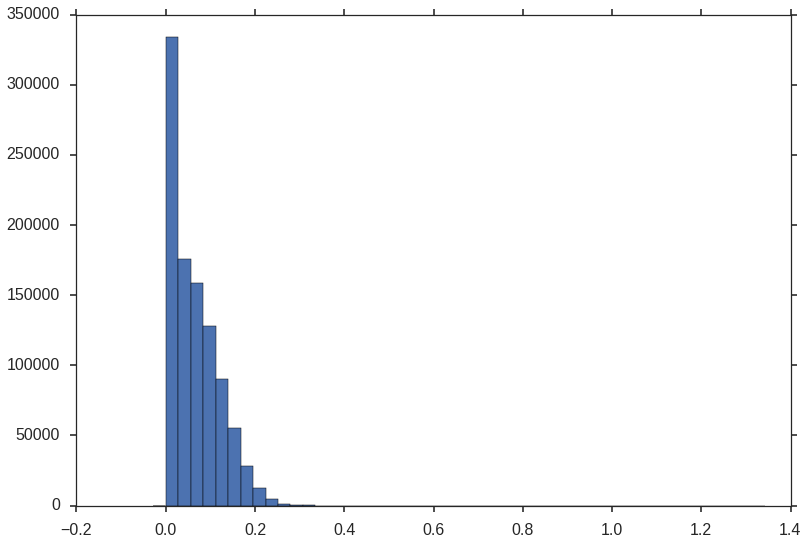

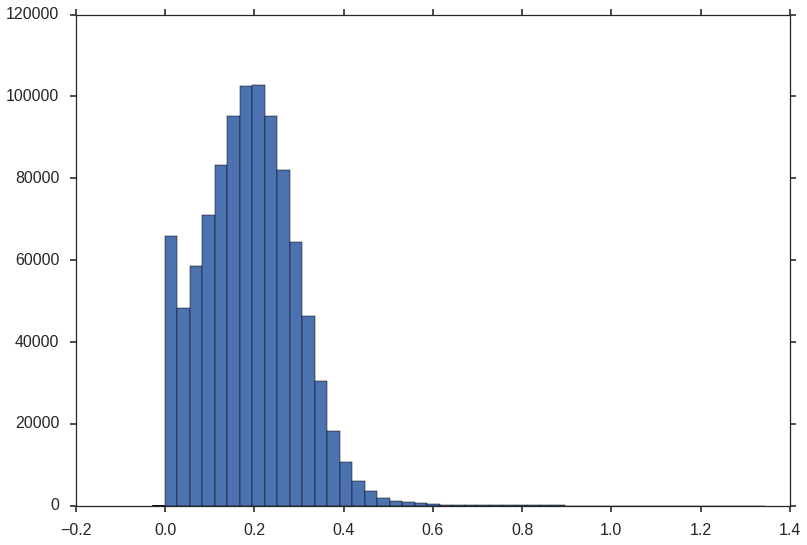

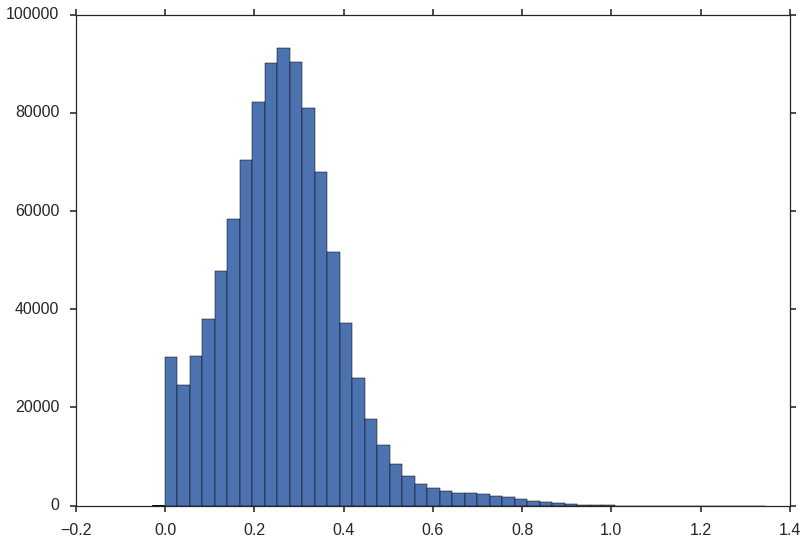

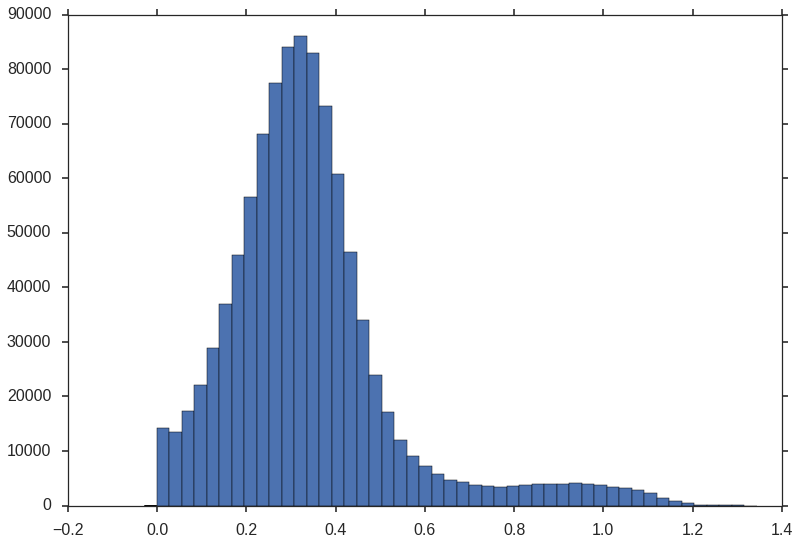

In [83]:
for i in range(4):
    p.hist(chan_holes_7_nc[i, :, :].ravel(), bins=np.linspace(chan_holes_7_nc.min(), chan_holes_7_nc.max(), 50))
    p.show()

Success! Artifacts are largely gone in this version. But the strength of the 2 prominent bubbles are a little diminshed (one especially).

How easily can this be cleaned up? Try an open with a beam element

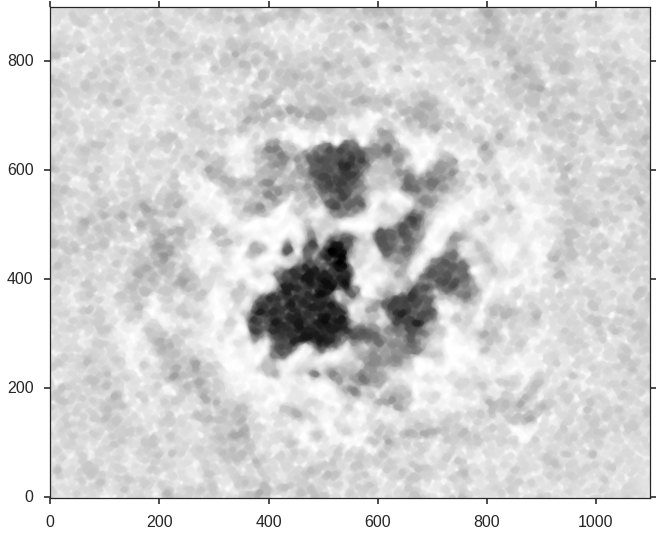

In [125]:
from scipy import ndimage as nd
beam_struct = cube.beam.as_tophat_kernel(get_pixel_scales(cube.wcs)).array > 0
beam_struct = beam_struct.astype(int)

p.imshow(nd.grey_opening(nd.median_filter(output_7_nc, size=6), structure=beam_struct), origin='lower')

Meh.

**8) Pre-smoothing data, beam element structures**

Convolve with the beam.

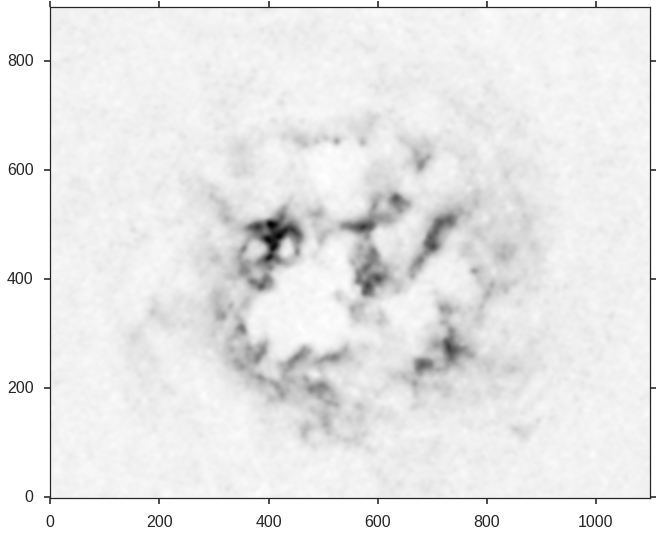

In [127]:
smooth_15 = convolve_fft(cube[15, :, :].value, beam_struct)

p.imshow(smooth_15, origin='lower')

In [128]:
chan_holes_8 = prog_BTH(smooth_15,
                      wcs=cube.wcs,
                      scales=[1, 5, 10, 20],  # N times beam width
                      beam=cube.beam)

output_8 = np.max(chan_holes_8, axis=0)

1
5
10
20


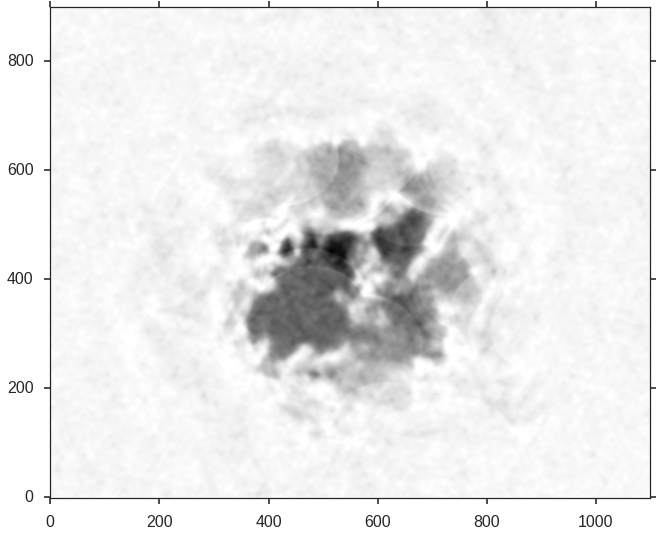

In [129]:
p.imshow(output_8, origin='lower')

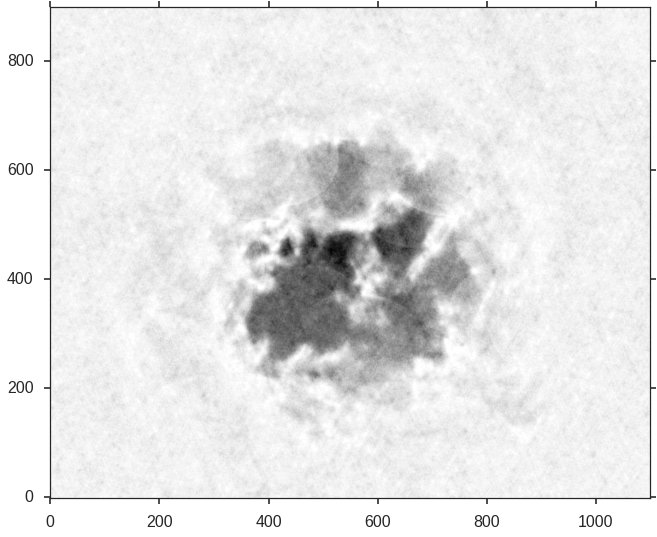

In [130]:
p.imshow(output_2, origin='lower')

No real benefit to the smoothing.

**9) Arctan transform, beam structures**

I think the arctan will flatten a bit more since the normalization seems more free than the astropy arcsinh implementation.

In [131]:
def atan_transform(array, thresh):
    return np.arctan(array/thresh)


In [135]:
chan15_mean = np.mean(cube[15, :, :])
chan15_std = np.std(cube[15, :, :])
thresh = chan15_mean + 2*chan15_std
print thresh

0.0034758024849 Jy


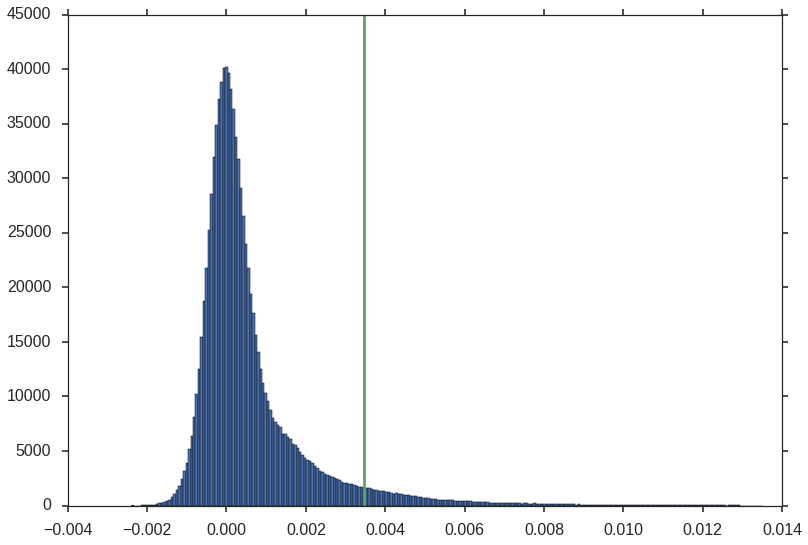

In [137]:
hist = p.hist(cube[15, :, :].value.ravel(), bins=256)
p.plot([thresh.value]*2, [0,45000])

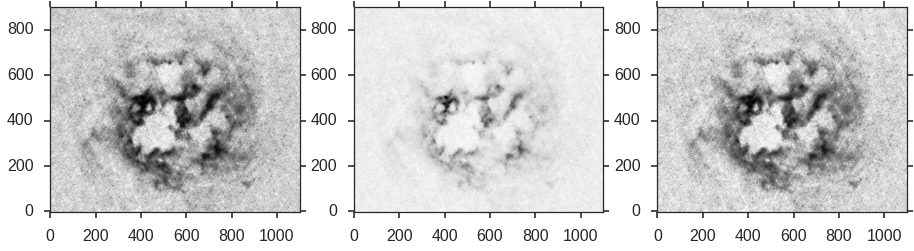

In [144]:
chan15_atan = atan_transform(cube[15, :, :].value, thresh.value)
p.subplot(131)
p.imshow(chan15_atan, origin='lower')
p.subplot(132)
p.imshow(cube[15, :, :].value, origin='lower')
p.subplot(133)
p.imshow(cube_15_arcsinh_noclip, origin='lower')
p.tight_layout()

Looks pretty similar to the arcsinh. See what happens with the bubbles, then maybe lower the arctan elbow.

In [145]:
chan_holes_9 = prog_BTH(chan15_atan,
                        wcs=cube.wcs,
                        scales=[1, 5, 10, 20],  # N times beam width
                        beam=cube.beam)

output_9 = np.max(chan_holes_9, axis=0)

1
5
10
20


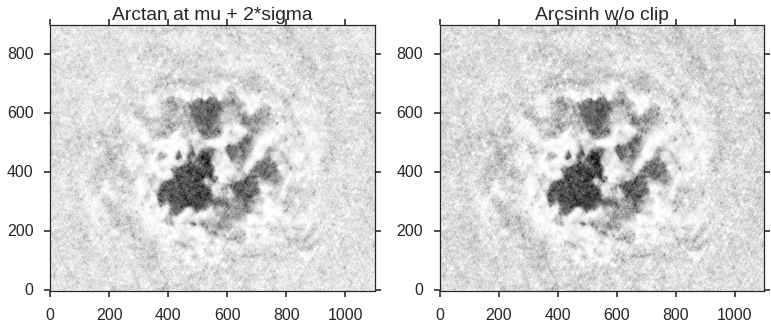

In [149]:
p.subplot(121)
p.title("Arctan at mu + 2*sigma")
p.imshow(output_9, origin='lower')
p.subplot(122)
p.title("Arcsinh w/o clip")
p.imshow(output_7_nc, origin='lower')

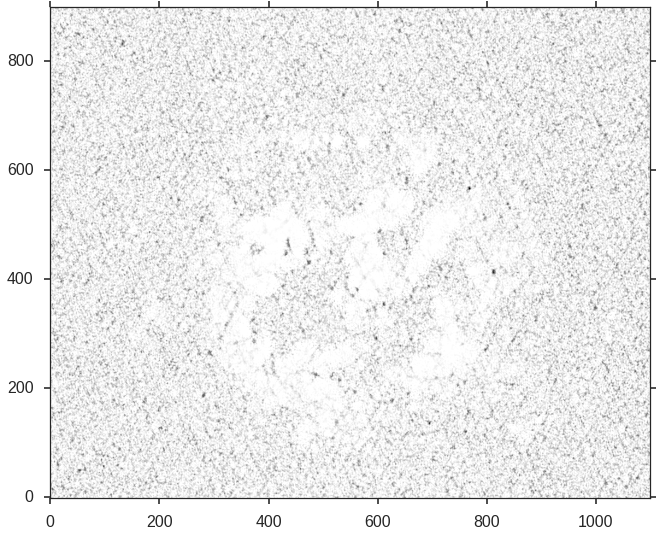

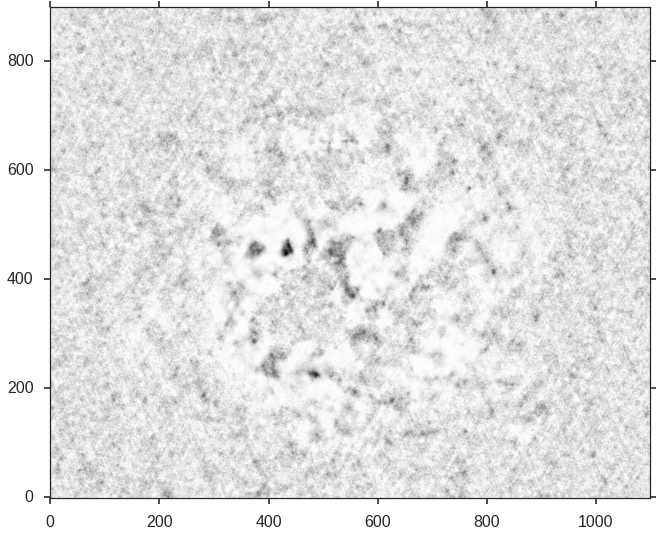

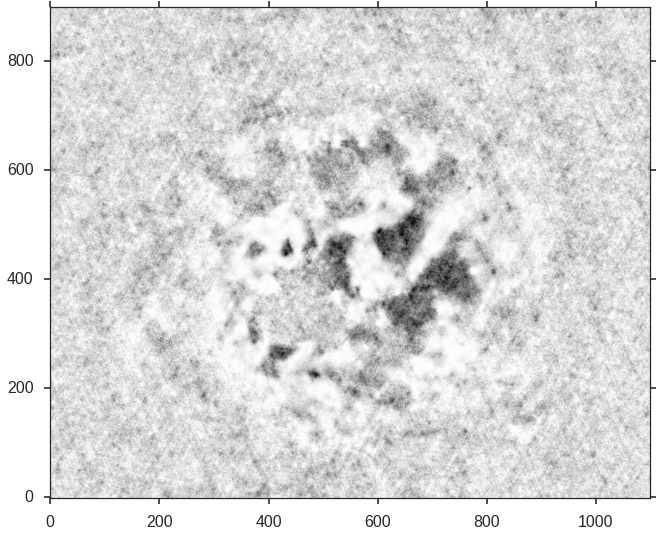

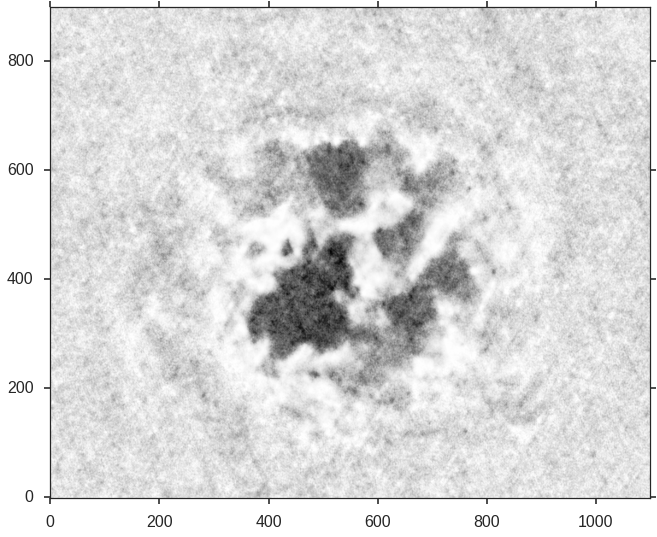

In [147]:
for i in range(4):
    p.imshow(chan_holes_9[i, :, :], origin='lower')
    p.show()

**10) Arctan at mu+sigma, beam structures**

In [155]:
chan15_atan_lower = atan_transform(cube[15, :, :].value, (chan15_mean+chan15_std).value)

chan_holes_10 = prog_BTH(chan15_atan_lower,
                        wcs=cube.wcs,
                        scales=[1, 5, 10, 20],  # N times beam width
                        beam=cube.beam)

output_10 = np.max(chan_holes_10, axis=0)

1
5
10
20


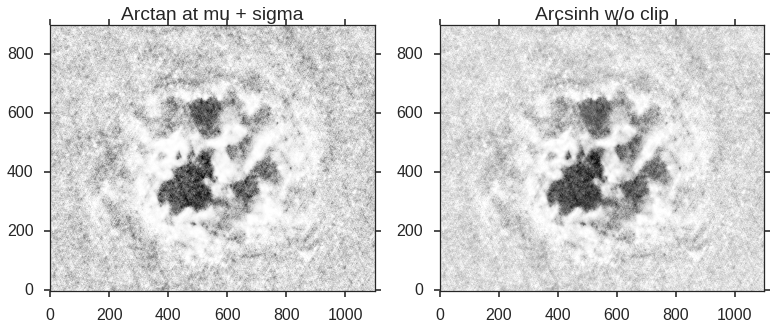

In [156]:
p.subplot(121)
p.title("Arctan at mu + sigma")
p.imshow(output_10, origin='lower')
p.subplot(122)
p.title("Arcsinh w/o clip")
p.imshow(output_7_nc, origin='lower')

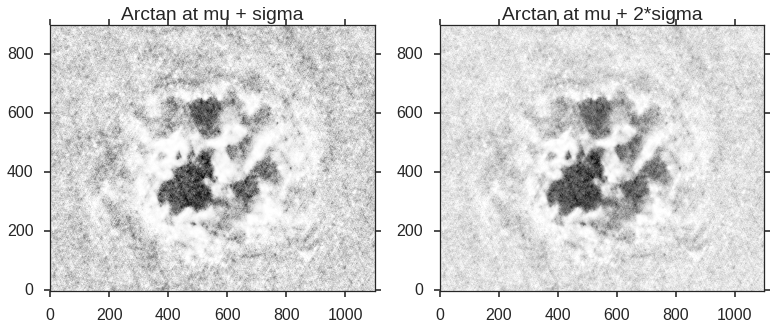

In [157]:
p.subplot(121)
p.title("Arctan at mu + sigma")
p.imshow(output_10, origin='lower')
p.subplot(122)
p.title("Arctan at mu + 2*sigma")
p.imshow(output_9, origin='lower')

0.506566882133


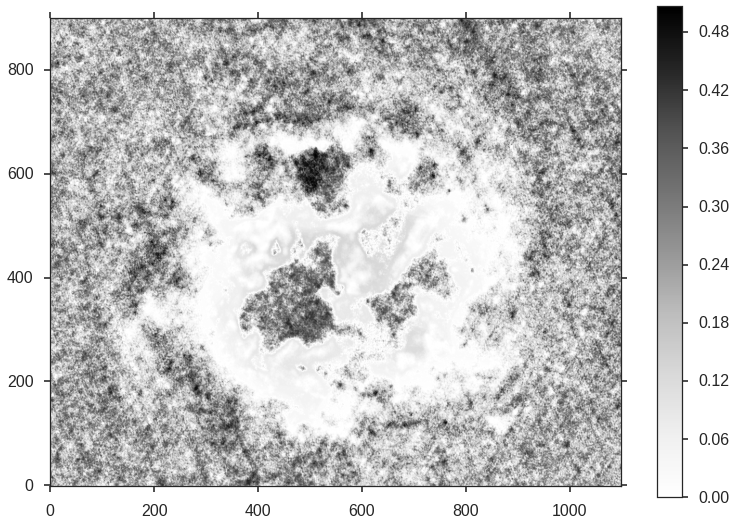

In [158]:
p.imshow(np.abs(output_10-output_9), origin='lower')
p.colorbar()
print(np.abs(output_10-output_9).max())

In [221]:
chan15_atan.max() - chan15_atan.min()
output_10.max()

2.1604821681976318

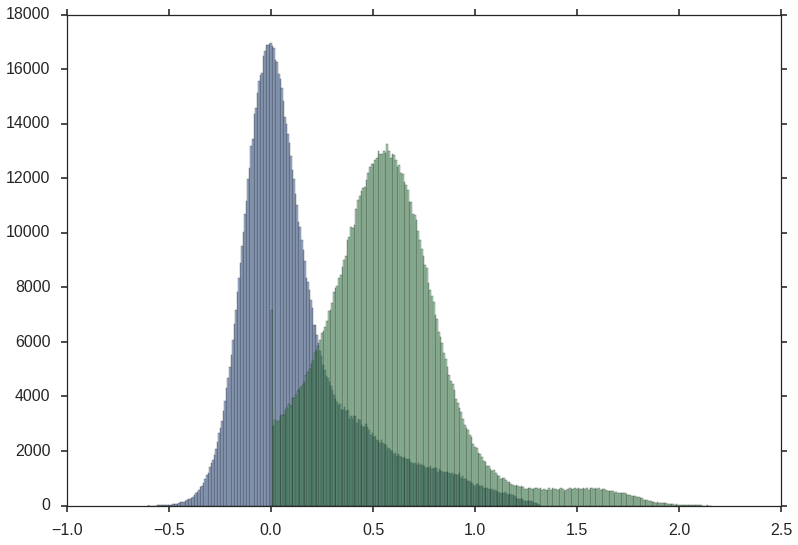

In [222]:
hist = p.hist(chan15_atan.ravel(), bins=256, alpha=0.5)
hist2 = p.hist(output_10.ravel(), bins=256, alpha=0.5)

The basic shapes don't really change, so stick with case **9**

**11) Using SNR to find bubbles?**

<matplotlib.contour.QuadContourSet instance at 0x7f05942428c0>

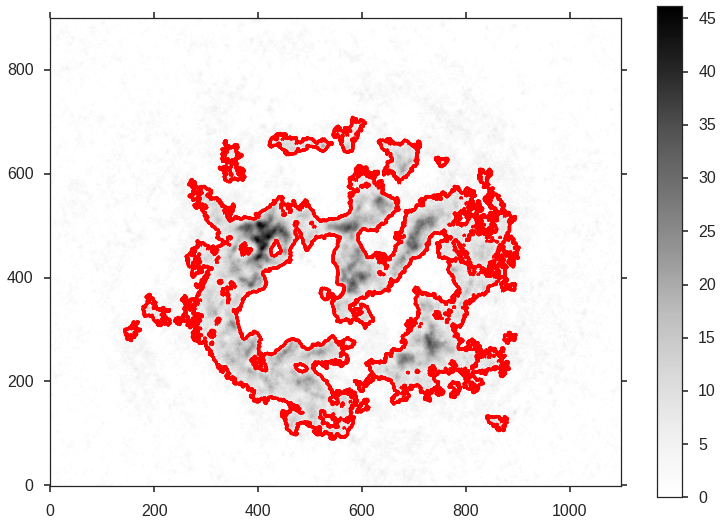

In [244]:
chan15 = cube[15, :, :].value
chan15 = chan15/np.nanstd(chan15[chan15<0])
chan15[chan15 <= 0.0] = 0.0
p.imshow(chan15, origin='lower')
p.colorbar()
p.contour(mo.remove_small_objects(chan15>5, 200), colors='r')

In [240]:
chan_holes_11 = prog_BTH(chan15,
                        wcs=cube.wcs,
                        scales=[1, 5, 10, 20],  # N times beam width
                        beam=cube.beam)

output_11 = np.max(chan_holes_11, axis=0)

1
5
10
20


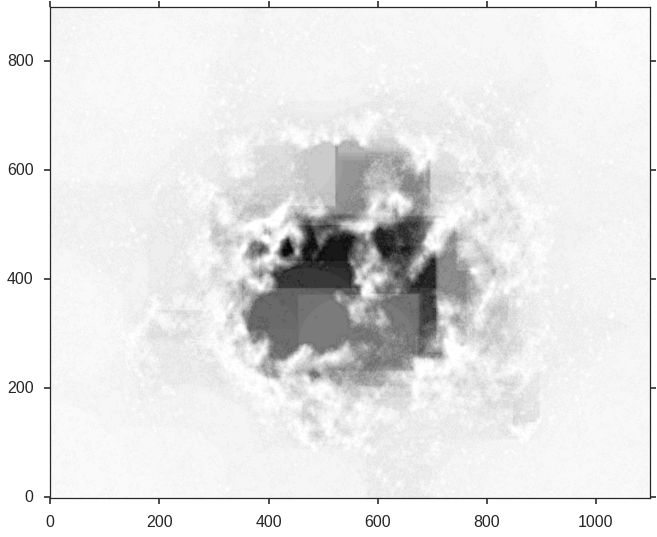

In [241]:
p.imshow(output_11, origin='lower')

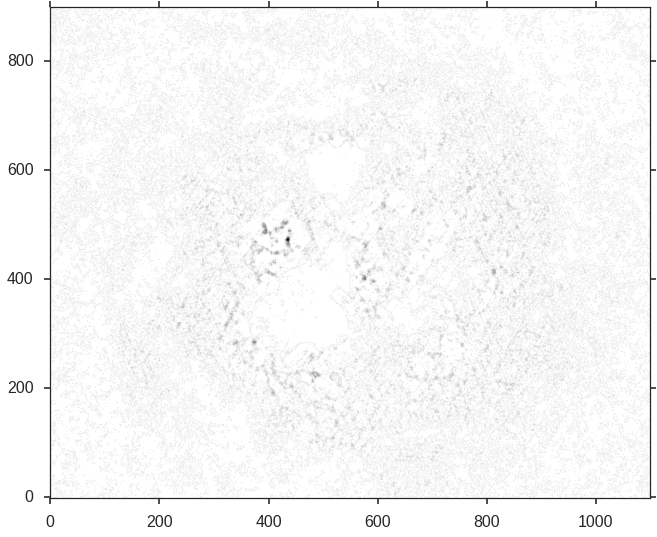

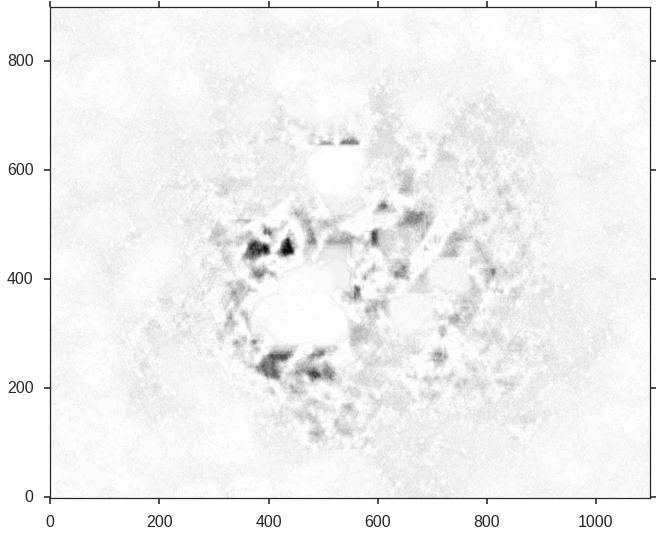

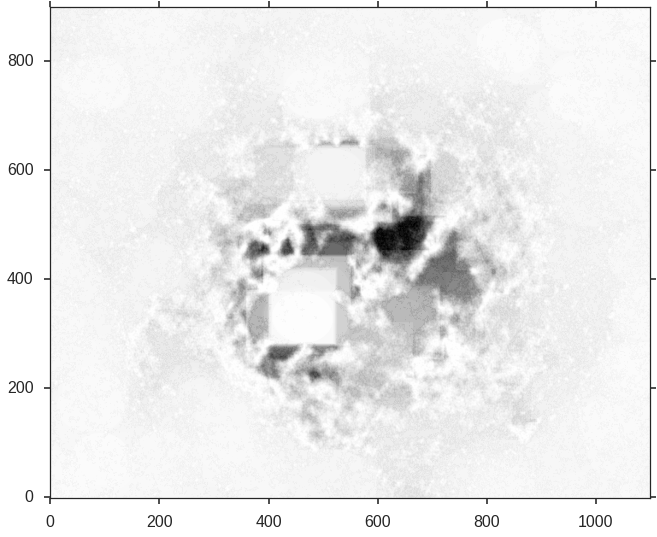

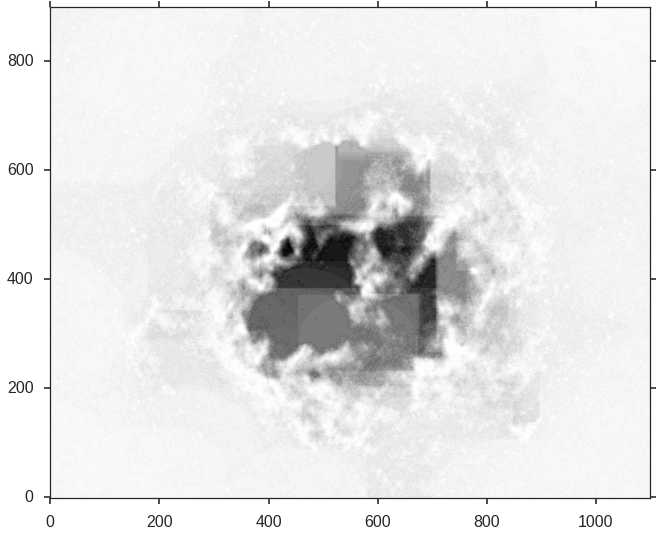

In [243]:
for i in range(4):
    p.imshow(chan_holes_11[i, :, :], origin='lower')
    p.show()

Not useful... that hard cut-off to zero really causes issues.